# Lesson 1: Advanced RAG Pipeline

In [1]:
import os
from dotenv import load_dotenv

# Load environment variables from .env file
load_dotenv()


# Ensure the OpenAI API key is set in the environment
openai_api_key = os.getenv('OPENAI_API_KEY')
if not openai_api_key:
    raise ValueError("OPENAI_API_KEY environment variable is not set")

In [1]:
#%pip install -qU langchain-openai==0.1.25

Note: you may need to restart the kernel to use updated packages.


In [1]:
#%pip install -qU langchain==0.2.16

Note: you may need to restart the kernel to use updated packages.


In [2]:
#!pip install llama_index --quiet

In [2]:
from llama_index.core import SimpleDirectoryReader

documents = SimpleDirectoryReader(
    input_files=["../docs/Basics of Writing Review Articles.pdf"]
).load_data()

In [3]:
print(type(documents), "\n")
print(len(documents), "\n")
print(type(documents[0]))
print(documents[0])

<class 'list'> 

6 

<class 'llama_index.core.schema.Document'>
Doc ID: a08fde49-8174-42d2-a02f-9e323c398f6d
Text: Evidence-based medicine forms the essence of medical practice in
the modern world. No wonder review articles are the mainstay for
evidence-based medicine. Review articles provide a critical summary of
the existing literature to explain the current state of scientiﬁc
evidence on a particular topic. A well-written review article must
summarize key...


## Basic RAG pipeline

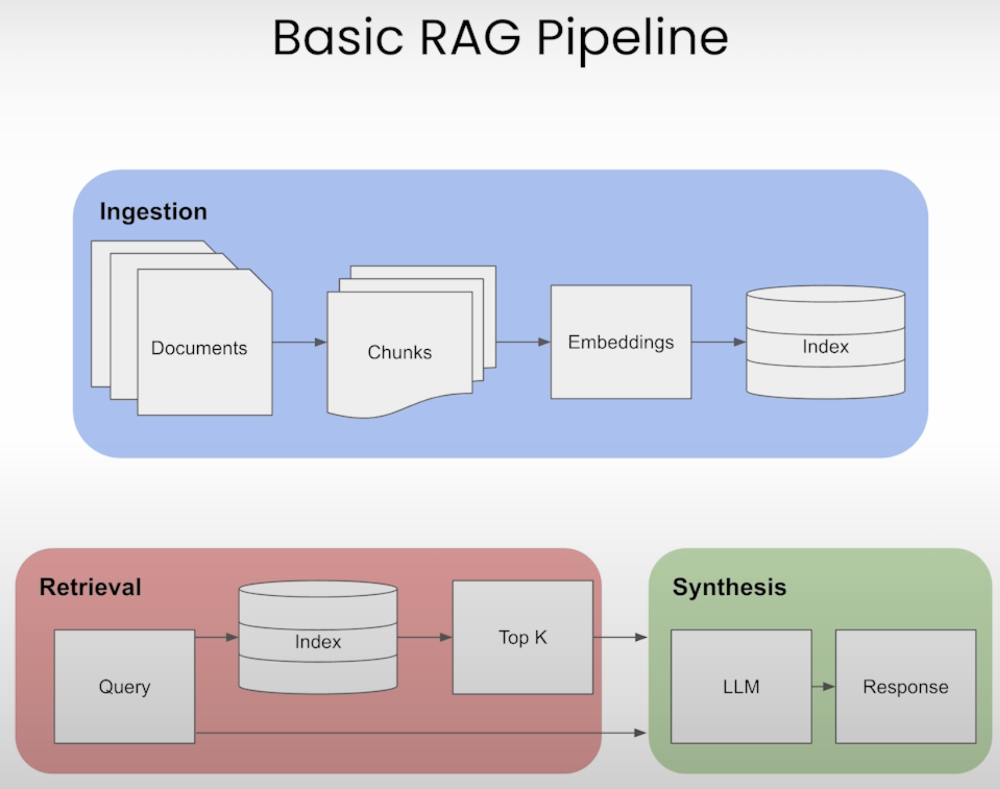

In [3]:
from llama_index.core import Document

document = Document(text="\n\n".join([doc.text for doc in documents]))

In [1]:
#%pip install llama-index-embeddings-openai --quiet

Note: you may need to restart the kernel to use updated packages.


In [4]:
from llama_index.llms.openai import OpenAI
from llama_index.embeddings.openai import OpenAIEmbedding
from llama_index.core import VectorStoreIndex

llm = OpenAI(model="gpt-4o-mini")
embed_model = OpenAIEmbedding(model="text-embedding-3-small")

index = VectorStoreIndex.from_documents(
                                       [document], embed_model=embed_model, llm=llm
)

In [5]:
query_engine = index.as_query_engine()

In [6]:
response = query_engine.query(
    "What are international guidelines to conduct reviews?"
)
print(str(response))

PRISMA, Cochrane, and JBI are international guidelines that provide detailed information on how to conduct reviews, starting from the planning and protocol writing phases. These guidelines aim to ensure transparent, unbiased, and complete reporting in review articles. Although primarily focused on systematic reviews, these guidelines can also serve as a basis for conducting other types of reviews.


## Evaluation setup using TruLens

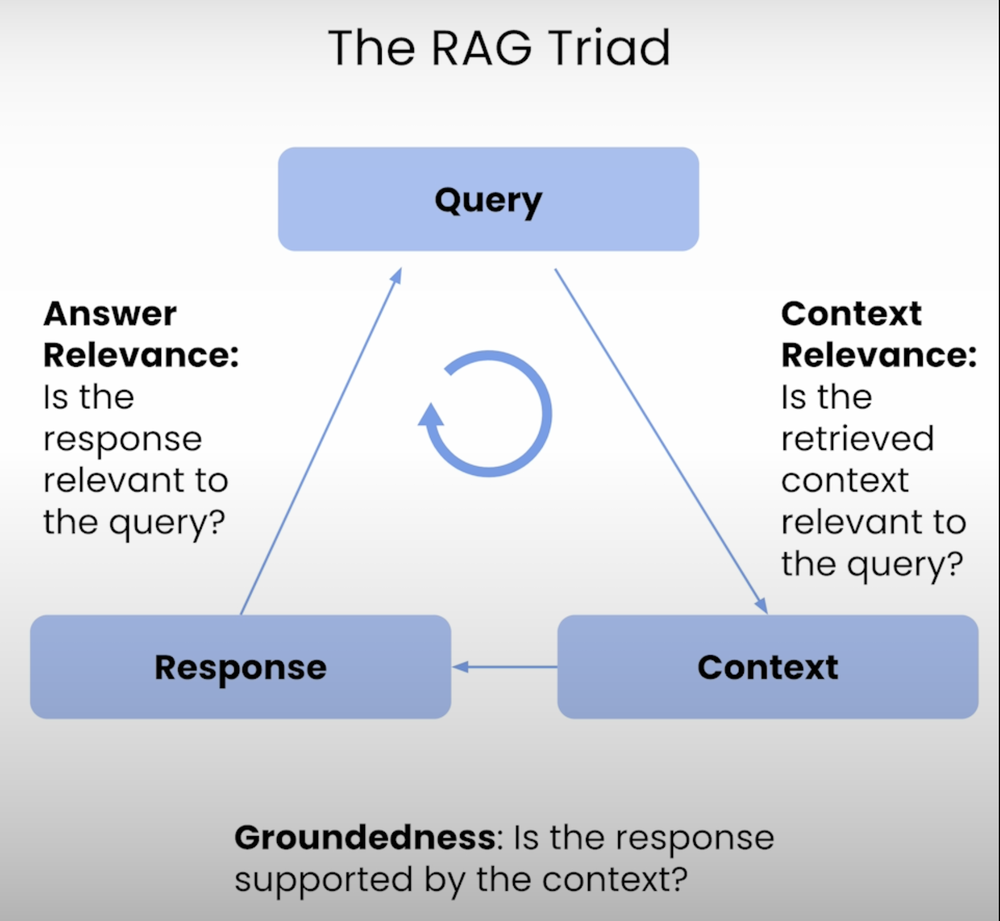

In [7]:
eval_questions = []
with open('../docs/eval_questions.txt', 'r') as file:
    for line in file:
        # Remove newline character and convert to integer
        item = line.strip()
        print(item)
        eval_questions.append(item)

What is the primary purpose of review articles in evidence-based medicine?
How do traditional reviews differ from systematic reviews in terms of methodology and structure?
What are the seven families of review types as categorized by Sutton et al.?
What are the key components that should be included in every review article, regardless of its type?
Why is the PRISMA guideline important for writing systematic reviews, and how can it be applied to other review types?
What are the common elements of a review article written in the IMRaD format?
How should the introduction of a review article be structured to highlight the need for the review?
What specific information should be included in the methods section of a review paper?
How can a literature summary table improve the readability and comprehensiveness of a review article?
What should the discussion section of a review article focus on, and why is it important to highlight the limitations of both the included literature and the review

In [8]:
# You can try your own question:
new_question = "What are international guidelines to conduct reviews?"
eval_questions.append(new_question)

In [9]:
print(eval_questions)

['What is the primary purpose of review articles in evidence-based medicine?', 'How do traditional reviews differ from systematic reviews in terms of methodology and structure?', 'What are the seven families of review types as categorized by Sutton et al.?', 'What are the key components that should be included in every review article, regardless of its type?', 'Why is the PRISMA guideline important for writing systematic reviews, and how can it be applied to other review types?', 'What are the common elements of a review article written in the IMRaD format?', 'How should the introduction of a review article be structured to highlight the need for the review?', 'What specific information should be included in the methods section of a review paper?', 'How can a literature summary table improve the readability and comprehensiveness of a review article?', 'What should the discussion section of a review article focus on, and why is it important to highlight the limitations of both the inclu

In [14]:
#!pip install trulens-eval --quiet

In [30]:
#!pip install trulens-providers-openai --quiet

In [36]:
#!pip install trulens-apps-llamaindex --quiet

In [10]:
import numpy as np
from trulens.core.feedback.feedback import Feedback
from trulens.apps.llamaindex import TruLlama
from trulens.providers.openai import OpenAI

from trulens.core import TruSession

session = TruSession()
session.reset_database()

🦑 TruSession initialized with db url sqlite:///default.sqlite .
🛑 Secret keys may be written to the database. See the `database_redact_keys` option of `TruSession` to prevent this.


In [11]:
openai = OpenAI(model_engine="gpt-4o-mini")

qa_relevance = (
    Feedback(openai.relevance_with_cot_reasons, name="Answer Relevance")
    .on_input_output()
)

qs_relevance = (
    Feedback(openai.relevance_with_cot_reasons, name = "Context Relevance")
    .on_input()
    .on(TruLlama.select_source_nodes().node.text)
    .aggregate(np.mean)
)

groundedness = (
    Feedback(OpenAI.groundedness_measure_with_cot_reasons, name="Groundedness")
        .on(TruLlama.select_source_nodes().node.text)
        .on_output()
)

feedbacks = [qa_relevance, qs_relevance, groundedness]

def get_prebuilt_trulens_recorder(query_engine, app_id):
    tru_recorder = TruLlama(
        query_engine,
        app_id=app_id,
        feedbacks=feedbacks
        )
    return tru_recorder

✅ In Answer Relevance, input prompt will be set to __record__.main_input or `Select.RecordInput` .
✅ In Answer Relevance, input response will be set to __record__.main_output or `Select.RecordOutput` .
✅ In Context Relevance, input prompt will be set to __record__.main_input or `Select.RecordInput` .
✅ In Context Relevance, input response will be set to __record__.app.query.rets.source_nodes[:].node.text .
✅ In Groundedness, input self will be set to __record__.app.query.rets.source_nodes[:].node.text .
✅ In Groundedness, input source will be set to __record__.main_output or `Select.RecordOutput` .


In [12]:
tru_recorder = get_prebuilt_trulens_recorder(query_engine,
                                             app_id="Direct Query Engine")

In [13]:
with tru_recorder as recording:
    for question in eval_questions:
        response = query_engine.query(question)

In [15]:
records, feedback = session.get_records_and_feedback(app_ids=[])

In [16]:
records.head()

,app_id,app_json,type,record_id,input,output,tags,record_json,cost_json,perf_json,...,Context Relevance_calls,Answer Relevance feedback cost in USD,Groundedness feedback cost in USD,Context Relevance feedback cost in USD,app_name,app_version,latency,total_tokens,total_cost,cost_currency
0,app_hash_6e8221fde876d15698298cea8c0d1bd6,"{""tru_class_info"": {""name"": ""TruLlama"", ""modul...",RetrieverQueryEngine(llama_index.core.query_en...,record_hash_6e1c619e375a61bc87d27566d9073524,"""What is the primary purpose of review article...","""The primary purpose of review articles in evi...",-,"{""record_id"": ""record_hash_6e1c619e375a61bc87d...","{""n_requests"": 2, ""n_successful_requests"": 3, ...","{""start_time"": ""2025-01-22T12:53:36.556580"", ""...",...,[{'args': {'prompt': 'What is the primary purp...,0.000139,0.0,0.000479,Direct Query Engine,base,3,1628,0.002438,USD
1,app_hash_6e8221fde876d15698298cea8c0d1bd6,"{""tru_class_info"": {""name"": ""TruLlama"", ""modul...",RetrieverQueryEngine(llama_index.core.query_en...,record_hash_b3929e7268a7c070561598138055c5d3,"""How do traditional reviews differ from system...","""Traditional reviews and systematic reviews di...",-,"{""record_id"": ""record_hash_b3929e7268a7c070561...","{""n_requests"": 2, ""n_successful_requests"": 3, ...","{""start_time"": ""2025-01-22T12:53:40.184809"", ""...",...,[{'args': {'prompt': 'How do traditional revie...,0.000125,0.0,0.000468,Direct Query Engine,base,2,1666,0.002505,USD
2,app_hash_6e8221fde876d15698298cea8c0d1bd6,"{""tru_class_info"": {""name"": ""TruLlama"", ""modul...",RetrieverQueryEngine(llama_index.core.query_en...,record_hash_f2d15d6f17744e95883235e17e7ec930,"""What are the seven families of review types a...","""The seven families of review types as categor...",-,"{""record_id"": ""record_hash_f2d15d6f17744e95883...","{""n_requests"": 2, ""n_successful_requests"": 3, ...","{""start_time"": ""2025-01-22T12:53:42.681168"", ""...",...,[{'args': {'prompt': 'What are the seven famil...,0.000119,0.0,0.000479,Direct Query Engine,base,1,1605,0.002383,USD
3,app_hash_6e8221fde876d15698298cea8c0d1bd6,"{""tru_class_info"": {""name"": ""TruLlama"", ""modul...",RetrieverQueryEngine(llama_index.core.query_en...,record_hash_e5d506b1af6ce049d71126fa10c1c3b5,"""What are the key components that should be in...","""Every review article, regardless of its type,...",-,"{""record_id"": ""record_hash_e5d506b1af6ce049d71...","{""n_requests"": 2, ""n_successful_requests"": 3, ...","{""start_time"": ""2025-01-22T12:53:44.566335"", ""...",...,[{'args': {'prompt': 'What are the key compone...,0.000136,0.0,0.000478,Direct Query Engine,base,2,1649,0.002453,USD
4,app_hash_6e8221fde876d15698298cea8c0d1bd6,"{""tru_class_info"": {""name"": ""TruLlama"", ""modul...",RetrieverQueryEngine(llama_index.core.query_en...,record_hash_d7b59b84a314165d668d1857a608d75b,"""Why is the PRISMA guideline important for wri...","""The PRISMA guideline is important for writing...",-,"{""record_id"": ""record_hash_d7b59b84a314165d668...","{""n_requests"": 2, ""n_successful_requests"": 3, ...","{""start_time"": ""2025-01-22T12:53:46.765346"", ""...",...,[{'args': {'prompt': 'Why is the PRISMA guidel...,0.000148,0.0,0.000497,Direct Query Engine,base,2,1705,0.002543,USD


In [17]:
from trulens.dashboard import run_dashboard

run_dashboard(session)

Starting dashboard ...
Config file already exists. Skipping writing process.
Credentials file already exists. Skipping writing process.


Accordion(children=(VBox(children=(VBox(children=(Label(value='STDOUT'), Output())), VBox(children=(Label(valu…

Dashboard started at http://192.168.11.8:49616 .


<Popen: returncode: None args: ['streamlit', 'run', '--server.headless=True'...>

## Advanced RAG pipeline

### 1. Sentence Window retrieval

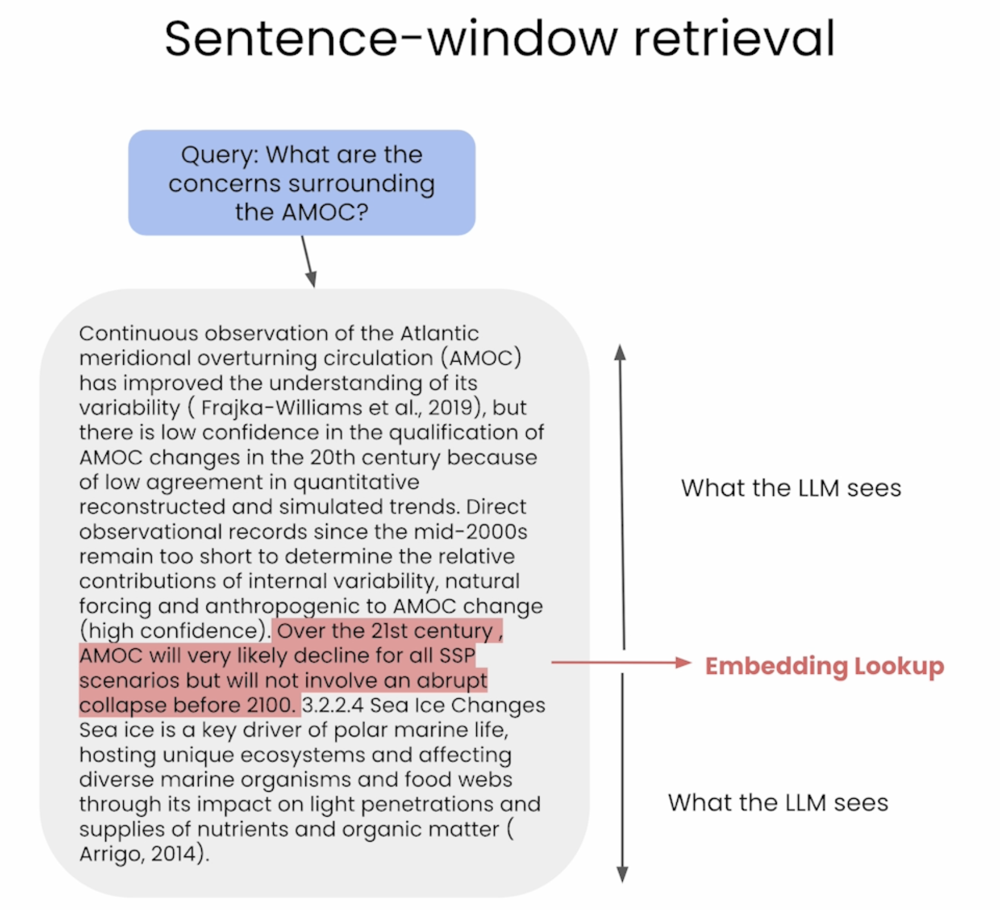

In [18]:
from llama_index.llms.openai import OpenAI
from llama_index.embeddings.openai import OpenAIEmbedding

llm = OpenAI(model="gpt-4o-mini", temperature=0.1)
embed_model = OpenAIEmbedding(model="text-embedding-3-small")

In [19]:
from llama_index.core import VectorStoreIndex, StorageContext
from llama_index.core.node_parser import SentenceWindowNodeParser
from llama_index.core.postprocessor import MetadataReplacementPostProcessor
from llama_index.core.postprocessor import SentenceTransformerRerank
from llama_index.core import load_index_from_storage

def build_sentence_window_index(
    document, llm=llm, embed_model=embed_model, save_dir="../data/sentence_index"
):
    # create the sentence window node parser w/ default settings
    node_parser = SentenceWindowNodeParser.from_defaults(
        window_size=3,
        window_metadata_key="window",
        original_text_metadata_key="original_text"
    )
    
    if not os.path.exists(save_dir):
        sentence_index = VectorStoreIndex.from_documents(
            [document], embed_model=embed_model, llm=llm, node_parser=node_parser
        )
        sentence_index.storage_context.persist(persist_dir=save_dir)
    else:
        sentence_index = load_index_from_storage(
            StorageContext.from_defaults(persist_dir=save_dir),
            embed_model=embed_model, llm=llm, node_parser=node_parser
        )

    return sentence_index

In [20]:
sentence_index = build_sentence_window_index(
    document,
    llm=llm,
    embed_model=embed_model,
    save_dir="../data/sentence_index"
)

In [28]:
#pip install -U sentence-transformers --quiet

Note: you may need to restart the kernel to use updated packages.


In [21]:
def get_sentence_window_query_engine(
    sentence_index,
    similarity_top_k=6,
    rerank_top_n=2,
):
    # define postprocessors
    postproc = MetadataReplacementPostProcessor(target_metadata_key="window")
    rerank = SentenceTransformerRerank(
        top_n=rerank_top_n, model="BAAI/bge-reranker-base"
    )

    sentence_window_engine = sentence_index.as_query_engine(
        similarity_top_k=similarity_top_k, node_postprocessors=[postproc, rerank]
    )
    return sentence_window_engine

In [22]:
sentence_window_engine = get_sentence_window_query_engine(sentence_index)

/opt/miniconda3/envs/envai/lib/python3.11/site-packages/huggingface_hub/file_download.py:797: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [23]:
window_response = sentence_window_engine.query(
    "What is a good review?"
)
print(str(window_response))

A good review is one that provides a critical summary of existing literature on a particular topic, summarizes key research findings, references important articles, describes areas of agreement and debates, points out gaps in knowledge, depicts unanswered questions, and suggests directions for future research. It should have a predefined methodology clearly explained in the text, be written in a structured format following the "introduction, methods, results, and discussion (IMRaD)" format, and include a well-defined reporting standard. Additionally, a good review should have a clear title containing keywords related to the topic, an informative introduction explaining the necessity of the review, a detailed methods section outlining search strategies and inclusion/exclusion criteria, a results section presenting findings with literature summary tables, and a discussion section providing interpretation, expert opinion, and implications for future research and clinical practice.


In [24]:
session.reset_database()

tru_recorder_sentence_window = get_prebuilt_trulens_recorder(
    sentence_window_engine,
    app_id = "Sentence Window Query Engine"
)

In [25]:
for question in eval_questions:
    with tru_recorder_sentence_window as recording:
        response = sentence_window_engine.query(question)
        print(question)
        print(str(response))

What is the primary purpose of review articles in evidence-based medicine?
The primary purpose of review articles in evidence-based medicine is to provide a critical summary of the existing literature on a particular topic. They aim to explain the current state of scientific evidence, summarize key research findings, reference important articles, describe areas of agreement and controversies, identify gaps in knowledge, present unanswered questions, and suggest directions for future research.
How do traditional reviews differ from systematic reviews in terms of methodology and structure?
Traditional reviews and systematic reviews differ in terms of methodology and structure. Traditional reviews typically cover various aspects of a topic without a specific methodology, while systematic reviews have a well-defined, rigorous methodology aimed at addressing a specific question. Traditional reviews are more narrative and subjective, while systematic reviews follow specific reporting standar

In [ ]:
session.get_leaderboard(app_ids=[])

In [28]:
run_dashboard(session)

Starting dashboard ...
Config file already exists. Skipping writing process.
Credentials file already exists. Skipping writing process.
Dashboard already running at path:   Network URL: http://192.168.11.8:49616



<Popen: returncode: None args: ['streamlit', 'run', '--server.headless=True'...>

### 2. Auto-merging retrieval

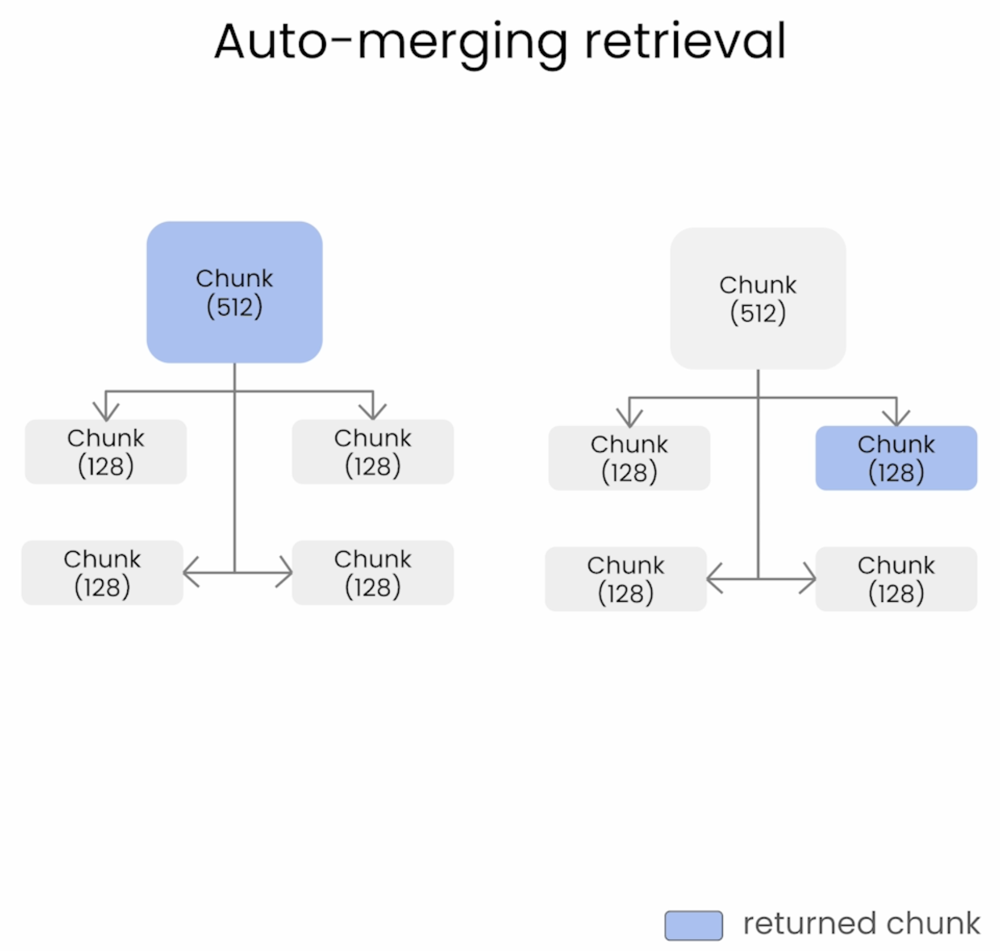

In [29]:
from llama_index.core.node_parser import HierarchicalNodeParser
from llama_index.core.node_parser import get_leaf_nodes
from llama_index.core.storage import StorageContext
from llama_index.core.retrievers import AutoMergingRetriever
from llama_index.core.postprocessor import SentenceTransformerRerank
from llama_index.core.query_engine import RetrieverQueryEngine


def build_automerging_index(
    documents,
    llm=llm,
    embed_model=embed_model,
    save_dir="../data/merging_index",
    chunk_sizes=None,
):
    chunk_sizes = chunk_sizes or [2048, 512, 128]
    node_parser = HierarchicalNodeParser.from_defaults(chunk_sizes=chunk_sizes)
    nodes = node_parser.get_nodes_from_documents(documents)
    leaf_nodes = get_leaf_nodes(nodes)
    
    storage_context = StorageContext.from_defaults()
    storage_context.docstore.add_documents(nodes)

    if not os.path.exists(save_dir):
        automerging_index = VectorStoreIndex(
            leaf_nodes, storage_context=storage_context, llm=llm, embed_model=embed_model
        )
        automerging_index.storage_context.persist(persist_dir=save_dir)
    else:
        automerging_index = load_index_from_storage(
            StorageContext.from_defaults(persist_dir=save_dir),
            llm=llm, embed_model=embed_model
        )
    return automerging_index

In [30]:
automerging_index = build_automerging_index(
    documents,
    llm,
    embed_model=embed_model,
    save_dir="../data/merging_index"
)

In [31]:
def get_automerging_query_engine(
    automerging_index,
    similarity_top_k=12,
    rerank_top_n=2,
):
    base_retriever = automerging_index.as_retriever(similarity_top_k=similarity_top_k)
    retriever = AutoMergingRetriever(
        base_retriever, automerging_index.storage_context, verbose=True
    )
    rerank = SentenceTransformerRerank(
        top_n=rerank_top_n, model="BAAI/bge-reranker-base"
    )
    auto_merging_engine = RetrieverQueryEngine.from_args(
        retriever, node_postprocessors=[rerank]
    )
    return auto_merging_engine


In [32]:
automerging_query_engine = get_automerging_query_engine(
    automerging_index
)

/opt/miniconda3/envs/envai/lib/python3.11/site-packages/huggingface_hub/file_download.py:797: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [33]:
auto_merging_response = automerging_query_engine.query(
    "What is a good review?"
)
print(str(auto_merging_response))

> Merging 3 nodes into parent node.
> Parent node id: cafdb9ce-3bb7-4beb-b57e-df75d3c333bc.
> Parent node text: The methods section of the review paper should be written detailed enough to prove its adequacy a...

> Merging 4 nodes into parent node.
> Parent node id: 9e660991-3c40-4e94-b824-3c530ad91ece.
> Parent node text: Evidence-based medicine forms the essence of medical practice in the modern world. No wonder revi...

> Merging 5 nodes into parent node.
> Parent node id: b2380e0e-7a66-47b0-8fee-05a5058e81b0.
> Parent node text: •Independent of the review type, all reviews must have a predeﬁned methodology
•The methods utili...

> Merging 3 nodes into parent node.
> Parent node id: 4f0a2f0b-288f-4d83-88ad-d21195207e35.
> Parent node text: Evidence-based medicine forms the essence of medical practice in the modern world. No wonder revi...

A good review is one that provides a critical summary of existing literature on a specific topic, summarizes key research findings, references i

In [34]:
session.reset_database()

tru_recorder_automerging = get_prebuilt_trulens_recorder(automerging_query_engine,
                                                         app_id="Automerging Query Engine")

In [35]:
for question in eval_questions:
    with tru_recorder_automerging as recording:
        response = automerging_query_engine.query(question)
        print(question)
        print(response)

> Merging 4 nodes into parent node.
> Parent node id: 9e660991-3c40-4e94-b824-3c530ad91ece.
> Parent node text: Evidence-based medicine forms the essence of medical practice in the modern world. No wonder revi...

> Merging 4 nodes into parent node.
> Parent node id: cafdb9ce-3bb7-4beb-b57e-df75d3c333bc.
> Parent node text: The methods section of the review paper should be written detailed enough to prove its adequacy a...

> Merging 4 nodes into parent node.
> Parent node id: b2380e0e-7a66-47b0-8fee-05a5058e81b0.
> Parent node text: •Independent of the review type, all reviews must have a predeﬁned methodology
•The methods utili...

> Merging 3 nodes into parent node.
> Parent node id: 4f0a2f0b-288f-4d83-88ad-d21195207e35.
> Parent node text: Evidence-based medicine forms the essence of medical practice in the modern world. No wonder revi...

What is the primary purpose of review articles in evidence-based medicine?
The primary purpose of review articles in evidence-based medicine is 

In [ ]:
session.get_leaderboard(app_ids=[])

In [38]:
run_dashboard(session)

Starting dashboard ...
Config file already exists. Skipping writing process.
Credentials file already exists. Skipping writing process.
Dashboard already running at path:   Network URL: http://192.168.11.8:49616



<Popen: returncode: None args: ['streamlit', 'run', '--server.headless=True'...>

# Lesson 2: RAG Triad of metrics

In [1]:
import os
from dotenv import load_dotenv

# Load environment variables from .env file
load_dotenv()


# Ensure the OpenAI API key is set in the environment
openai_api_key = os.getenv('OPENAI_API_KEY')
if not openai_api_key:
    raise ValueError("OPENAI_API_KEY environment variable is not set")

In [39]:
from trulens.core import TruSession

session = TruSession()
session.reset_database()

In [40]:
from llama_index.core import SimpleDirectoryReader

documents = SimpleDirectoryReader(
    input_files=["../docs/Basics of Writing Review Articles.pdf"]
).load_data()

In [41]:
from llama_index.core import Document

document = Document(text="\n\n".\
                    join([doc.text for doc in documents]))

In [42]:
from llama_index.llms.openai import OpenAI
from llama_index.embeddings.openai import OpenAIEmbedding
from llama_index.core import VectorStoreIndex

llm = OpenAI(model="gpt-4o-mini", temperature=0.1)
embed_model = OpenAIEmbedding(model="text-embedding-3-small")

In [43]:
from llama_index.core import VectorStoreIndex, StorageContext
from llama_index.core.node_parser import SentenceWindowNodeParser
from llama_index.core.postprocessor import MetadataReplacementPostProcessor
from llama_index.core.postprocessor import SentenceTransformerRerank
from llama_index.core import load_index_from_storage

def build_sentence_window_index(
    document, llm=llm, embed_model=embed_model, save_dir="../data/sentence_index"
):
    # create the sentence window node parser w/ default settings
    node_parser = SentenceWindowNodeParser.from_defaults(
        window_size=3,
        window_metadata_key="window",
        original_text_metadata_key="original_text"
    )
    
    if not os.path.exists(save_dir):
        sentence_index = VectorStoreIndex.from_documents(
            [document], embed_model=embed_model, llm=llm, node_parser=node_parser
        )
        sentence_index.storage_context.persist(persist_dir=save_dir)
    else:
        sentence_index = load_index_from_storage(
            StorageContext.from_defaults(persist_dir=save_dir),
            embed_model=embed_model, llm=llm, node_parser=node_parser
        )

    return sentence_index

In [44]:
sentence_index = build_sentence_window_index(
    document,
    llm=llm,
    embed_model=embed_model,
    save_dir="../data/sentence_index"
)

In [45]:
def get_sentence_window_query_engine(
    sentence_index,
    similarity_top_k=6,
    rerank_top_n=2,
):
    # define postprocessors
    postproc = MetadataReplacementPostProcessor(target_metadata_key="window")
    rerank = SentenceTransformerRerank(
        top_n=rerank_top_n, model="BAAI/bge-reranker-base"
    )

    sentence_window_engine = sentence_index.as_query_engine(
        similarity_top_k=similarity_top_k, node_postprocessors=[postproc, rerank]
    )
    return sentence_window_engine

In [46]:
sentence_window_engine = get_sentence_window_query_engine(sentence_index)

/opt/miniconda3/envs/envai/lib/python3.11/site-packages/huggingface_hub/file_download.py:797: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [47]:
output = sentence_window_engine.query(
    "What are international guidelines to conduct reviews?")
output.response

'PRISMA, Cochrane, and JBI are international guidelines that provide detailed information on how to conduct reviews, starting from the planning and protocol writing phases. These guidelines aim to ensure transparent, unbiased, and complete reporting in review articles. Although primarily focused on systematic reviews, these guidelines can also serve as a basis for conducting other types of reviews. The PRISMA checklist is available online in various languages, including Turkish, at www.prisma-statement.org.'

## Feedback functions

In [48]:
import nest_asyncio

nest_asyncio.apply()

In [49]:
from trulens.providers.openai import OpenAI as fOpenAI

provider = fOpenAI(model_engine="gpt-4o-mini")

### 1. Answer Relevance

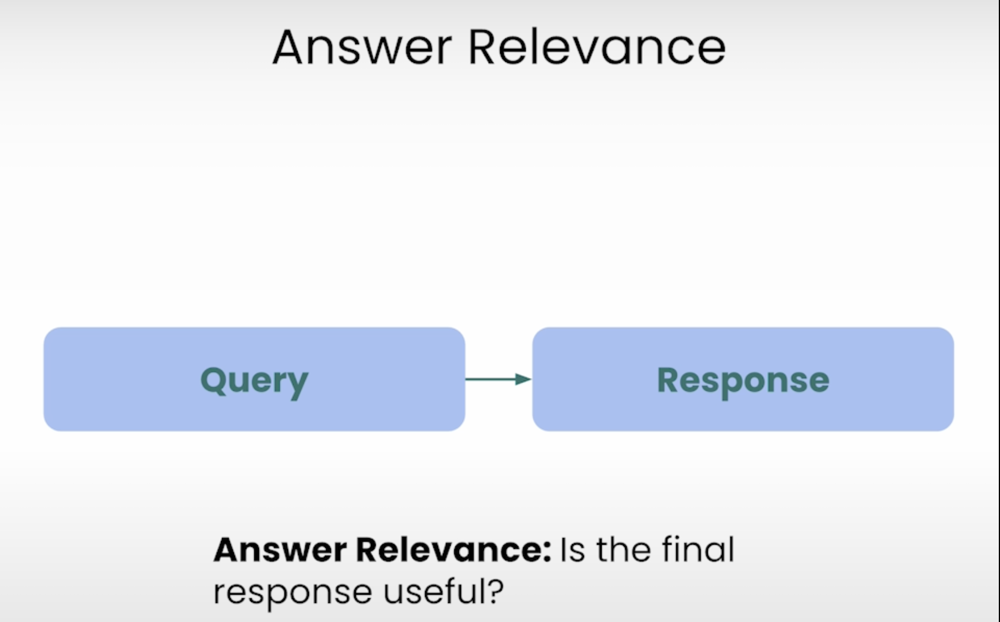

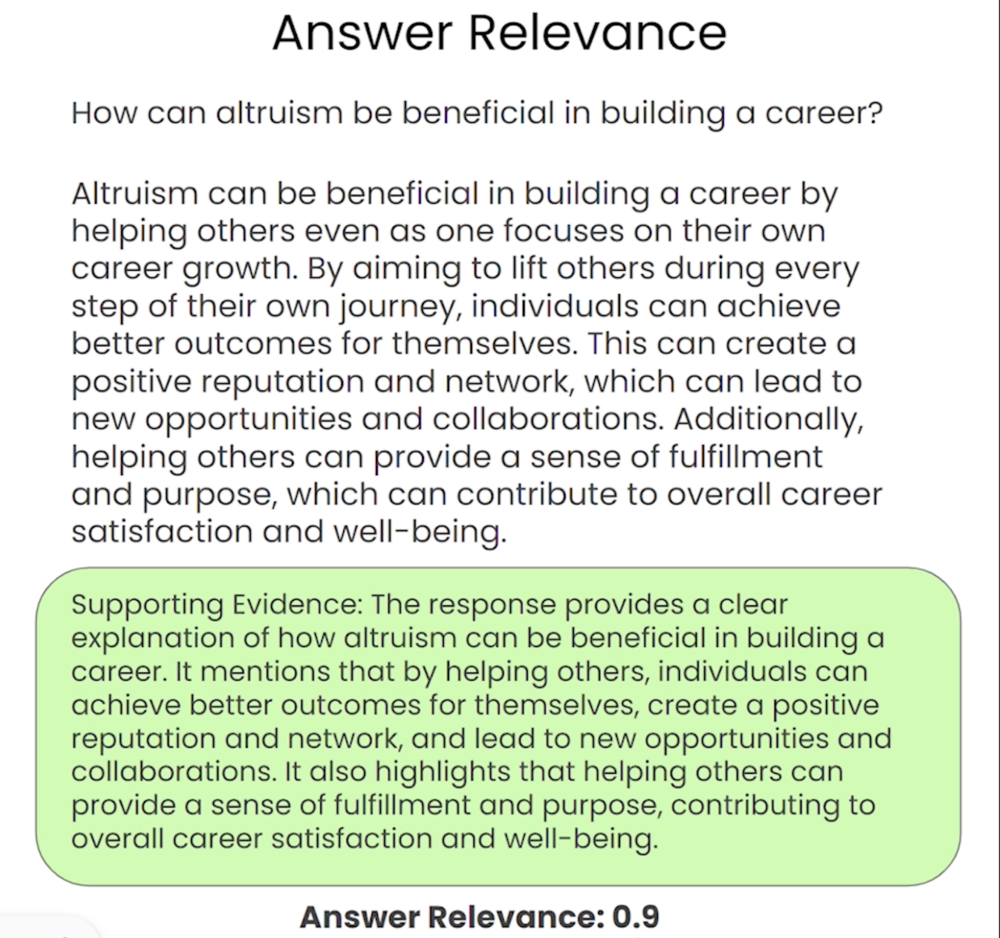

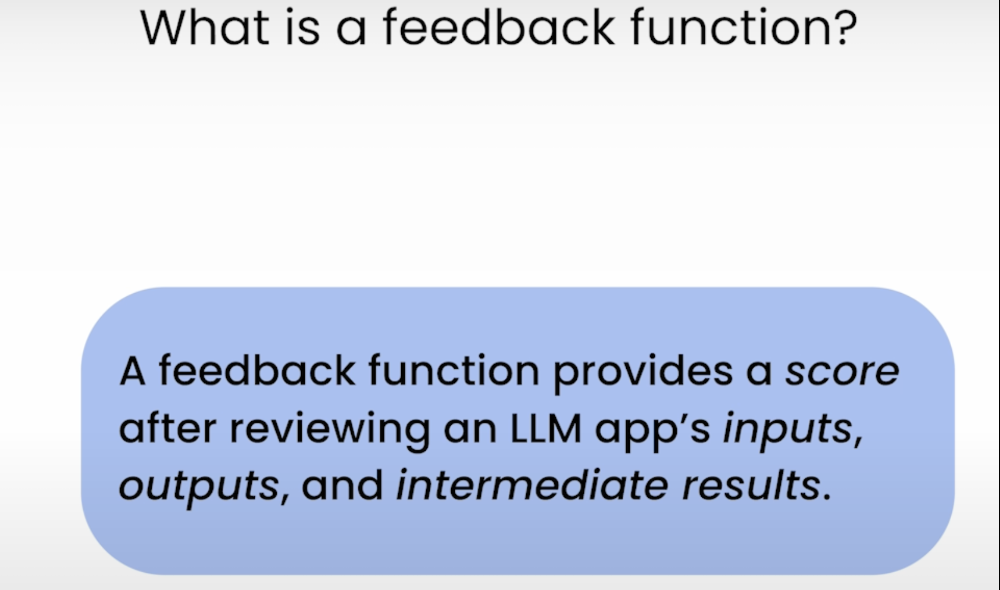

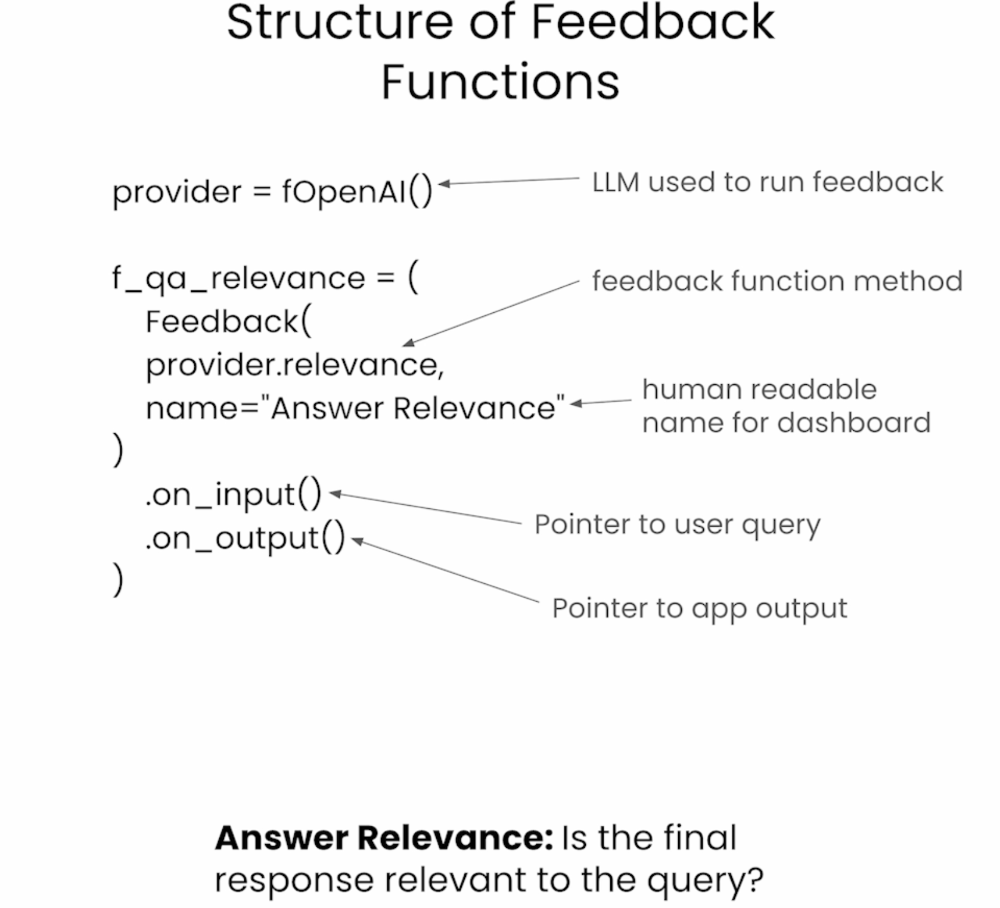

In [50]:
from trulens.core.feedback.feedback import Feedback

f_qa_relevance = Feedback(
    provider.relevance_with_cot_reasons,
    name="Answer Relevance"
).on_input_output()

✅ In Answer Relevance, input prompt will be set to __record__.main_input or `Select.RecordInput` .
✅ In Answer Relevance, input response will be set to __record__.main_output or `Select.RecordOutput` .


### 2. Context Relevance

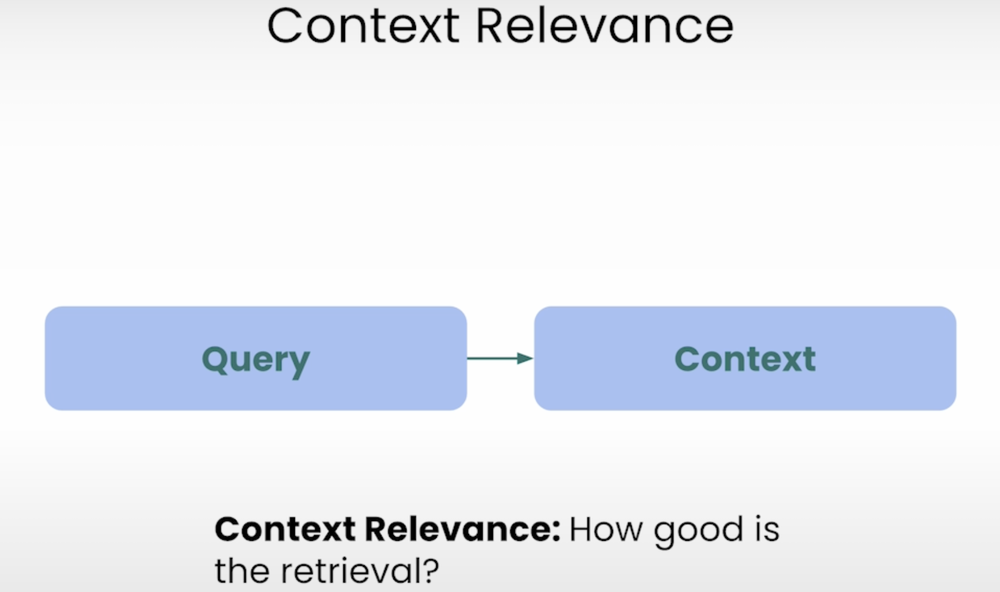

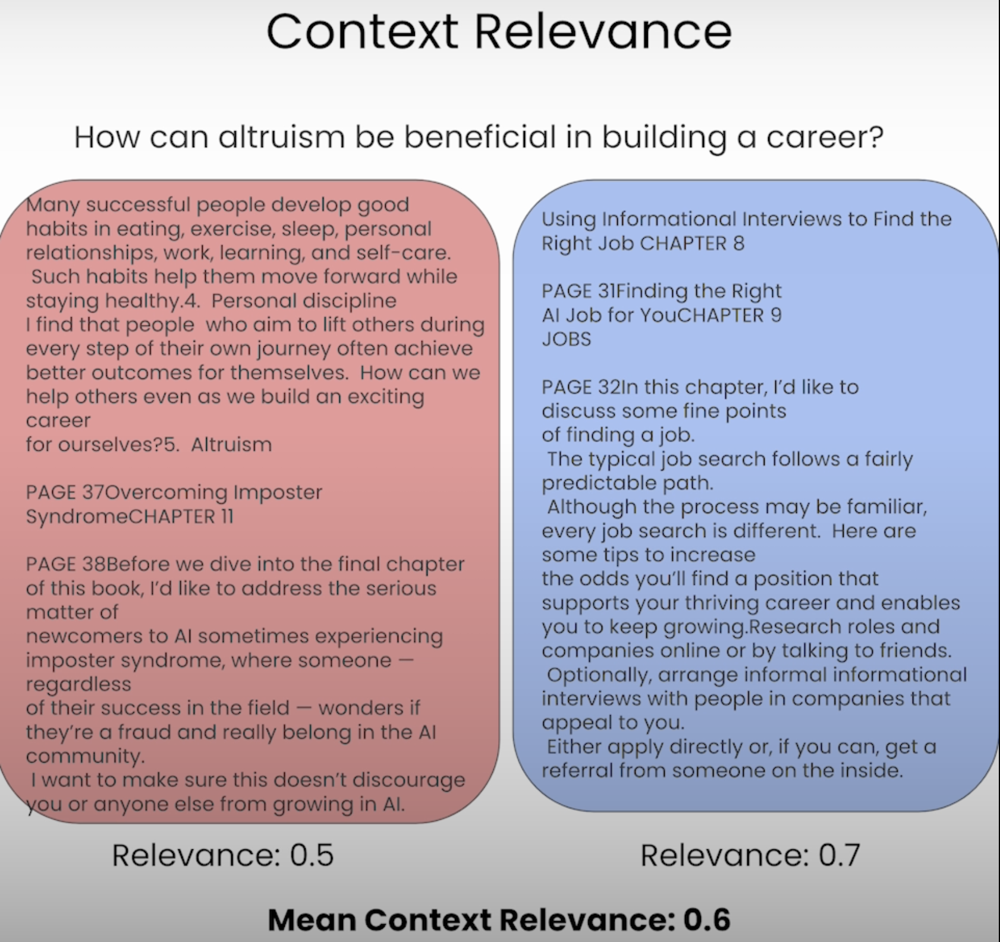

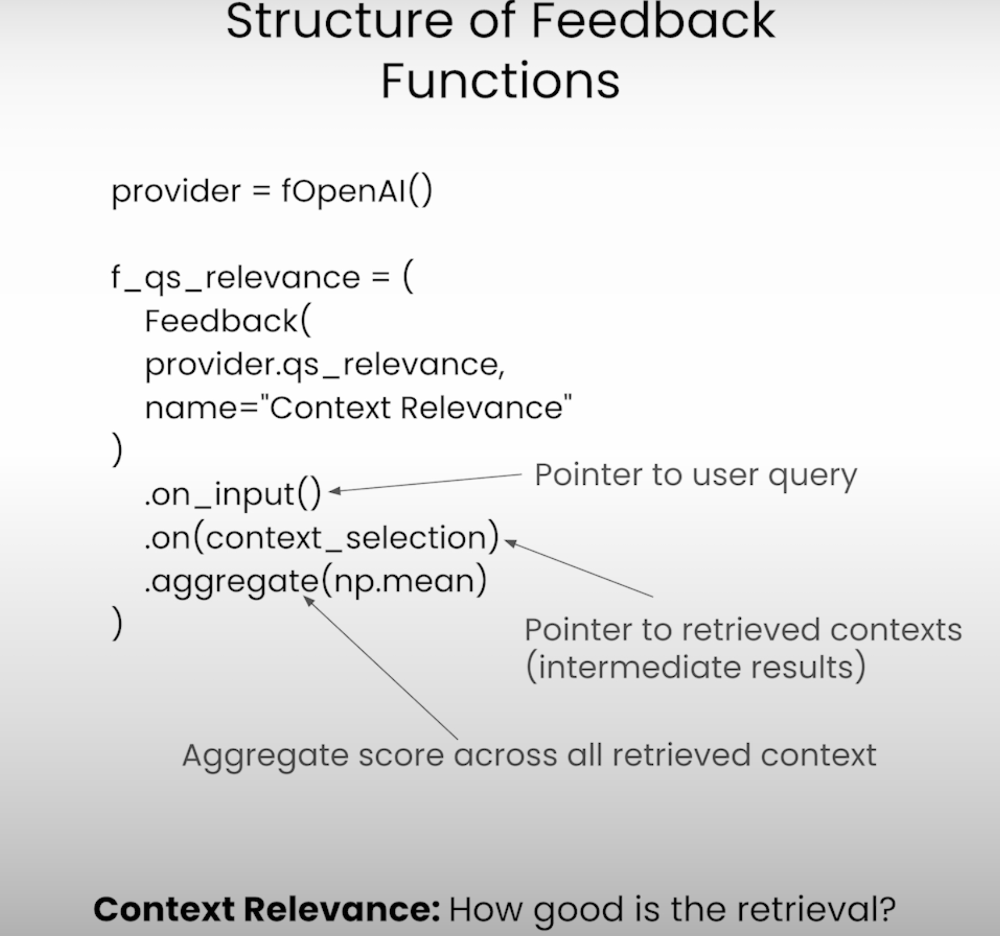

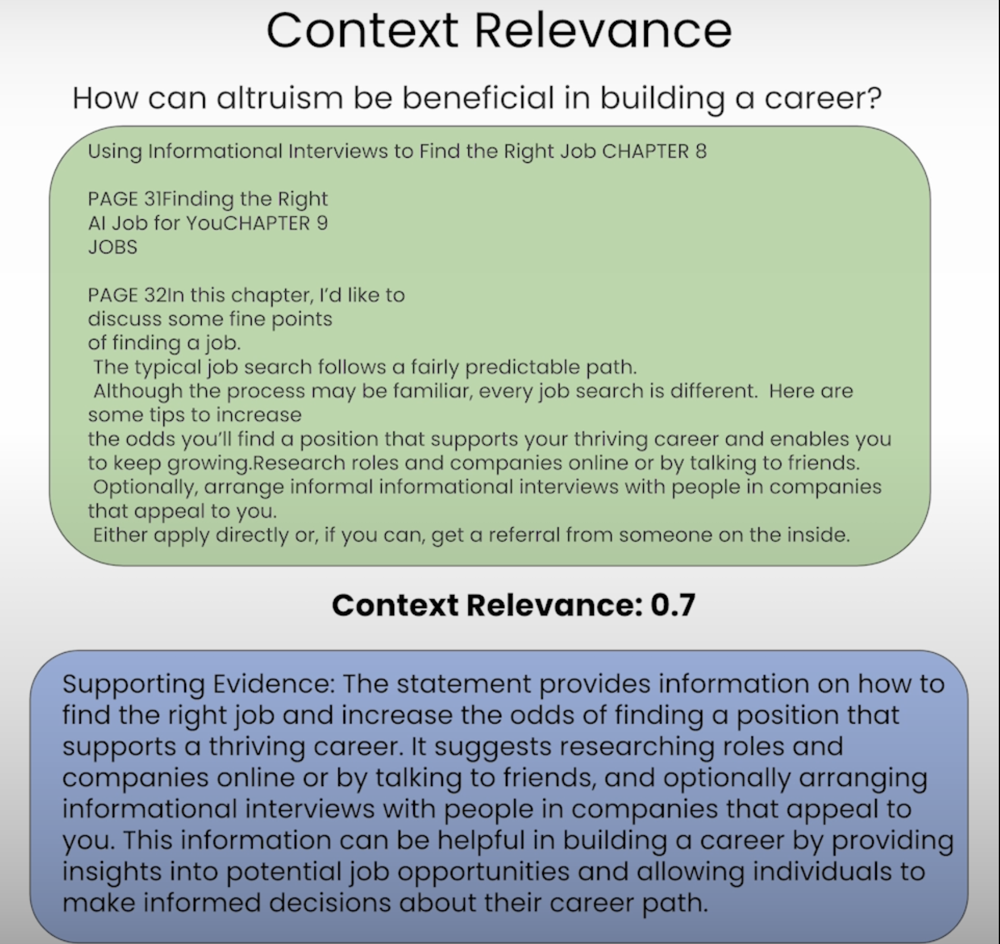

In [51]:
from trulens.apps.llamaindex import TruLlama

context_selection = TruLlama.select_source_nodes().node.text

In [52]:
import numpy as np

f_qs_relevance = (
    Feedback(provider.qs_relevance,
             name="Context Relevance")
    .on_input()
    .on(context_selection)
    .aggregate(np.mean)
)

✅ In Context Relevance, input args will be set to __record__.main_input or `Select.RecordInput` .
✅ In Context Relevance, input kwargs will be set to __record__.app.query.rets.source_nodes[:].node.text .


In [53]:
import numpy as np

f_qs_relevance = Feedback(provider.qs_relevance_with_cot_reasons,
             name="Context Relevance").on_input().on(context_selection).aggregate(np.mean)

✅ In Context Relevance, input args will be set to __record__.main_input or `Select.RecordInput` .
✅ In Context Relevance, input kwargs will be set to __record__.app.query.rets.source_nodes[:].node.text .


### 3. Groundedness

In [54]:
f_groundedness = Feedback(provider.groundedness_measure_with_cot_reasons,
             name="Groundedness"
            ).on(context_selection).on_output()

✅ In Groundedness, input source will be set to __record__.app.query.rets.source_nodes[:].node.text .
✅ In Groundedness, input statement will be set to __record__.main_output or `Select.RecordOutput` .


## Evaluation of the RAG application

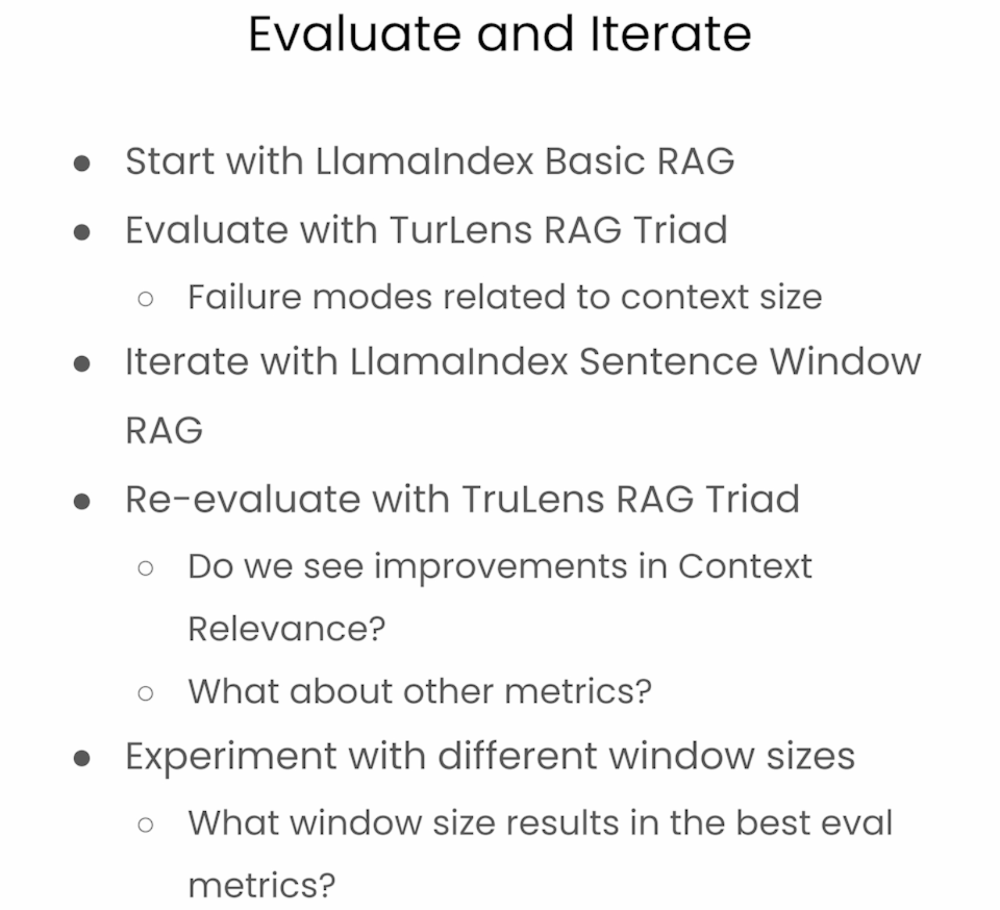

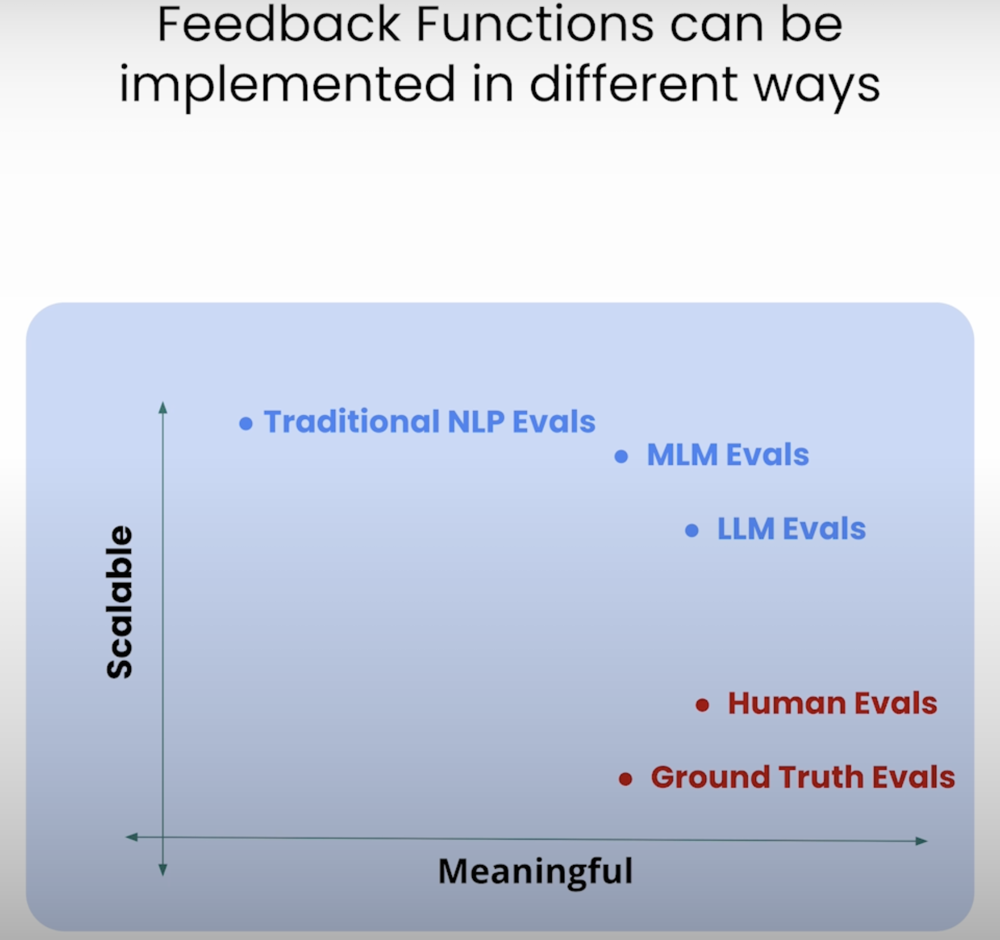

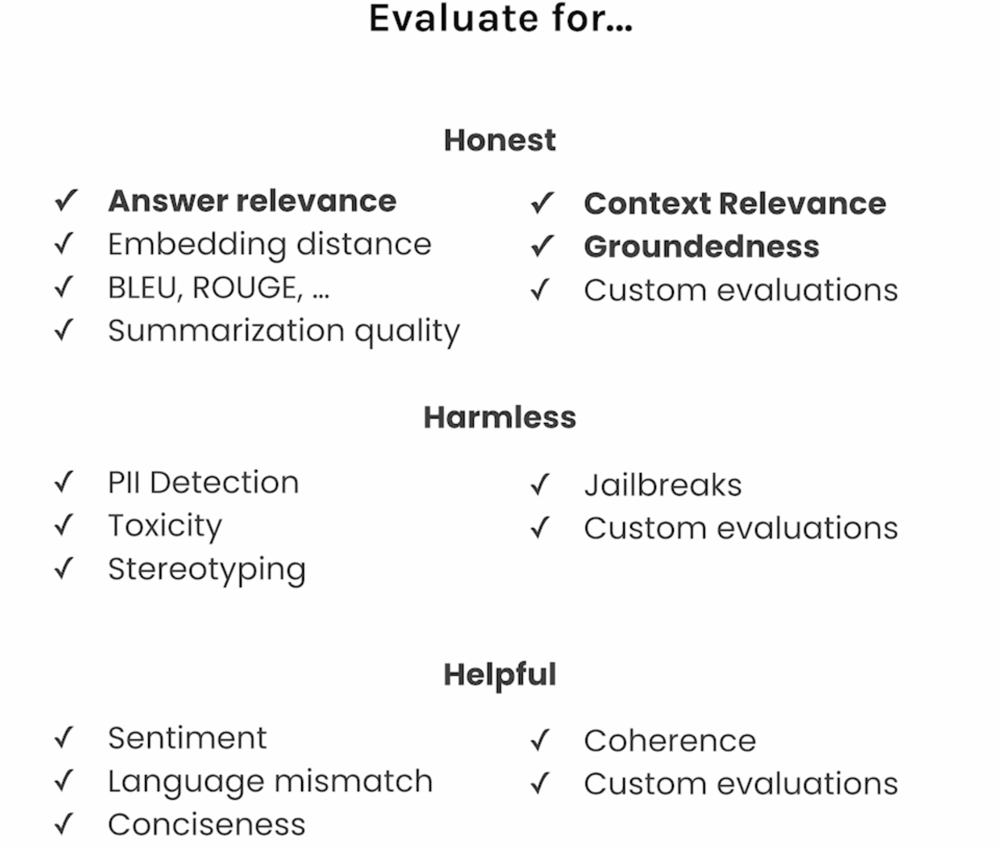

In [55]:
from trulens.apps.llamaindex import TruLlama

tru_recorder = TruLlama(
    sentence_window_engine,
    app_id="App_1",
    feedbacks=[
        f_qa_relevance,
        f_qs_relevance,
        f_groundedness
    ]
)

In [56]:
eval_questions = []
with open('../docs/eval_questions.txt', 'r') as file:
    for line in file:
        # Remove newline character and convert to integer
        item = line.strip()
        eval_questions.append(item)

In [29]:
eval_questions

['What is the primary purpose of review articles in evidence-based medicine?',
 'How do traditional reviews differ from systematic reviews in terms of methodology and structure?',
 'What are the seven families of review types as categorized by Sutton et al.?',
 'What are the key components that should be included in every review article, regardless of its type?',
 'Why is the PRISMA guideline important for writing systematic reviews, and how can it be applied to other review types?',
 'What are the common elements of a review article written in the IMRaD format?',
 'How should the introduction of a review article be structured to highlight the need for the review?',
 'What specific information should be included in the methods section of a review paper?',
 'How can a literature summary table improve the readability and comprehensiveness of a review article?',
 'What should the discussion section of a review article focus on, and why is it important to highlight the limitations of both 

In [57]:
for question in eval_questions:
    with tru_recorder as recording:
        sentence_window_engine.query(question)

In [58]:
records, feedback = session.get_records_and_feedback(app_ids=[])
records.head()

,app_id,app_json,type,record_id,input,output,tags,record_json,cost_json,perf_json,...,Context Relevance_calls,Groundedness feedback cost in USD,Answer Relevance feedback cost in USD,Context Relevance feedback cost in USD,app_name,app_version,latency,total_tokens,total_cost,cost_currency
0,app_hash_9a8bbe93b76fc0a0eca1a6fc7bd3027e,"{""tru_class_info"": {""name"": ""TruLlama"", ""modul...",RetrieverQueryEngine(llama_index.core.query_en...,record_hash_14eae8d3adfefc6b1db5e316ed8c18da,"""What is the primary purpose of review article...","""The primary purpose of review articles in evi...",-,"{""record_id"": ""record_hash_14eae8d3adfefc6b1db...","{""n_requests"": 2, ""n_successful_requests"": 3, ...","{""start_time"": ""2025-01-22T14:12:38.846190"", ""...",...,[],0.002125,0.000132,0.0,App_1,base,2,1628,0.002438,USD
1,app_hash_9a8bbe93b76fc0a0eca1a6fc7bd3027e,"{""tru_class_info"": {""name"": ""TruLlama"", ""modul...",RetrieverQueryEngine(llama_index.core.query_en...,record_hash_b0101bbefdd6a50b2ecaed4e69dd764d,"""How do traditional reviews differ from system...","""Traditional reviews do not have formal guidan...",-,"{""record_id"": ""record_hash_b0101bbefdd6a50b2ec...","{""n_requests"": 2, ""n_successful_requests"": 3, ...","{""start_time"": ""2025-01-22T14:12:42.155875"", ""...",...,[],0.006502,0.000132,0.0,App_1,base,3,1696,0.002565,USD
2,app_hash_9a8bbe93b76fc0a0eca1a6fc7bd3027e,"{""tru_class_info"": {""name"": ""TruLlama"", ""modul...",RetrieverQueryEngine(llama_index.core.query_en...,record_hash_229075de40efb7e229ff718a63b573a0,"""What are the seven families of review types a...","""The seven families of review types as categor...",-,"{""record_id"": ""record_hash_229075de40efb7e229f...","{""n_requests"": 2, ""n_successful_requests"": 3, ...","{""start_time"": ""2025-01-22T14:12:45.834985"", ""...",...,[],0.000772,0.000105,0.0,App_1,base,2,1605,0.002383,USD
3,app_hash_9a8bbe93b76fc0a0eca1a6fc7bd3027e,"{""tru_class_info"": {""name"": ""TruLlama"", ""modul...",RetrieverQueryEngine(llama_index.core.query_en...,record_hash_a5129a364ac74c3177f53519022c10fc,"""What are the key components that should be in...","""Every review article, regardless of its type,...",-,"{""record_id"": ""record_hash_a5129a364ac74c3177f...","{""n_requests"": 2, ""n_successful_requests"": 3, ...","{""start_time"": ""2025-01-22T14:12:49.154840"", ""...",...,[],0.002089,0.000133,0.0,App_1,base,2,1644,0.002443,USD
4,app_hash_9a8bbe93b76fc0a0eca1a6fc7bd3027e,"{""tru_class_info"": {""name"": ""TruLlama"", ""modul...",RetrieverQueryEngine(llama_index.core.query_en...,record_hash_344def4e30ef651f4bfbd18c9ae38074,"""Why is the PRISMA guideline important for wri...","""The PRISMA guideline is important for writing...",-,"{""record_id"": ""record_hash_344def4e30ef651f4bf...","{""n_requests"": 2, ""n_successful_requests"": 3, ...","{""start_time"": ""2025-01-22T14:12:52.307193"", ""...",...,[],0.003984,0.000139,0.0,App_1,base,3,1713,0.002559,USD


In [59]:
import pandas as pd

pd.set_option("display.max_colwidth", None)
records[["input", "output"] + feedback]

,input,output,Answer Relevance,Groundedness
0,"""What is the primary purpose of review articles in evidence-based medicine?""","""The primary purpose of review articles in evidence-based medicine is to provide a critical summary of the existing literature on a particular topic. They aim to explain the current state of scientific evidence, summarize key research findings, reference important articles, describe areas of agreement and controversies, point out gaps in knowledge, depict unanswered questions, and suggest directions for future research.""",1.0,0.916667
1,"""How do traditional reviews differ from systematic reviews in terms of methodology and structure?""","""Traditional reviews do not have formal guidance for their methodology, while systematic reviews adopt a specific aim and a well-defined, rigorous methodology. Traditional reviews cover advances in different aspects of a chosen topic within a broad spectrum, whereas systematic reviews focus on specific study types and have well-defined reporting standards and guidance. In terms of structure, traditional reviews are more narrative in nature and can take forms like narrative review, narrative summary, critical review, integrative review, and state of the art review. On the other hand, systematic reviews follow a structured format typically including sections like introduction, methods, results, and discussion, with a clear emphasis on transparency and completeness in reporting.""",1.0,0.750000
2,"""What are the seven families of review types as categorized by Sutton et al.?""","""The seven families of review types as categorized by Sutton et al. are traditional reviews, systematic reviews, review of reviews, rapid reviews, qualitative reviews, mixed method reviews, and purpose-specific reviews.""",1.0,0.500000
3,"""What are the key components that should be included in every review article, regardless of its type?""","""Every review article, regardless of its type, should include a prede\ufb01ned methodology that is clearly explained in the text. It should also have a structured format, typically following the \""introduction, methods, results, and discussion (IMRaD)\"" format, along with a title, abstract, key words, and references.""",1.0,0.833333
4,"""Why is the PRISMA guideline important for writing systematic reviews, and how can it be applied to other review types?""","""The PRISMA guideline is important for writing systematic reviews because it ensures transparent, unbiased, and complete reporting of the review process. It provides detailed information on how to conduct systematic reviews starting from the planning and protocol stages, ultimately enhancing the quality and reliability of the review. Additionally, the PRISMA guideline can be applied to other review types as a basis for conducting reviews, even though it is primarily focused on systematic reviews. By following the PRISMA guideline, authors can maintain consistency, clarity, and thoroughness in reporting their review methodology and results, regardless of the specific type of review being conducted.""",1.0,0.666667
5,"""What are the common elements of a review article written in the IMRaD format?""","""The common elements of a review article written in the IMRaD format are introduction, methods, results, and discussion. Additionally, the review article should include a title, abstract, key words, and references.""",1.0,0.500000
6,"""How should the introduction of a review article be structured to highlight the need for the review?""","""The introduction of a review article should be structured to explain why the review is necessary by discussing the latest developments in the subject area and emphasizing the unique contribution of the current review compared to previous ones. It should aim to persuade readers about the importance and relevance of the review by providing a clear rationale for undertaking it.""",1.0,0.750000
7,"""What specific information should be included in the methods section o

In [60]:
session.get_leaderboard(app_ids=[])

,,Answer Relevance,Groundedness,latency,total_cost
app_name,app_version,,,,
App_1,base,1.0,0.652778,2.4,0.002464


In [62]:
run_dashboard(session)

Starting dashboard ...
Config file already exists. Skipping writing process.
Credentials file already exists. Skipping writing process.
Dashboard already running at path:   Network URL: http://192.168.11.8:49616



<Popen: returncode: None args: ['streamlit', 'run', '--server.headless=True'...>

# Lesson 3: Sentence Window Retrieval

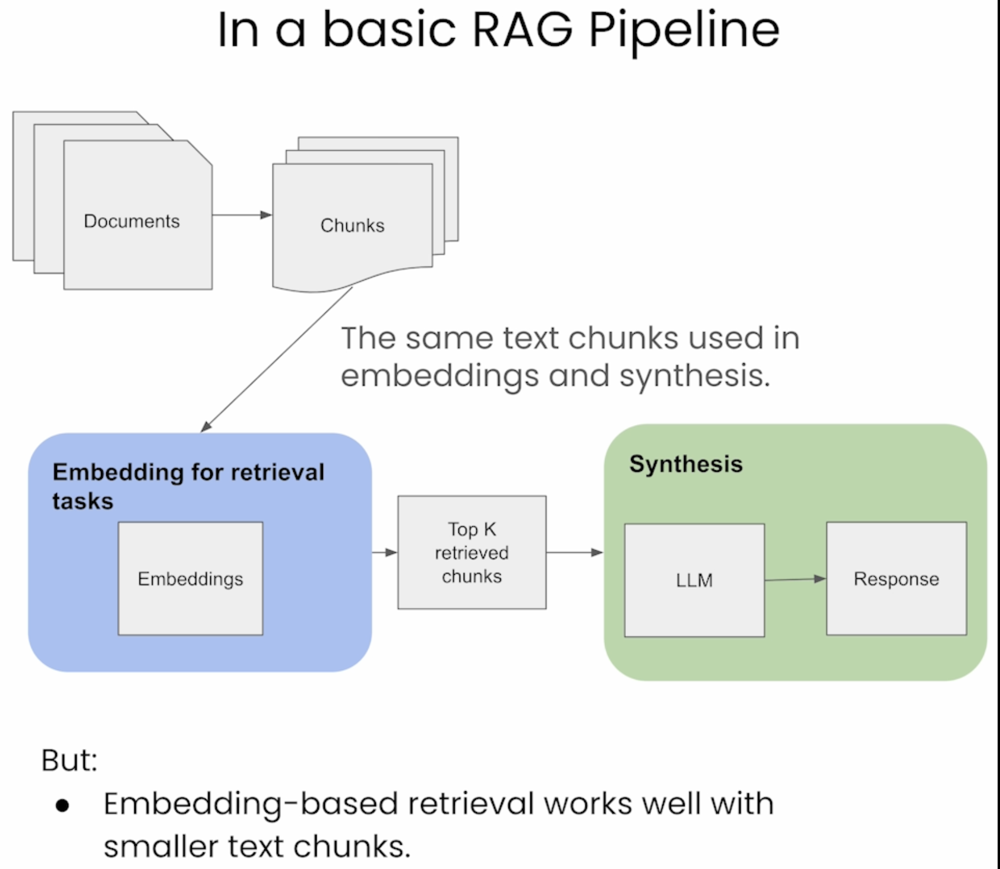

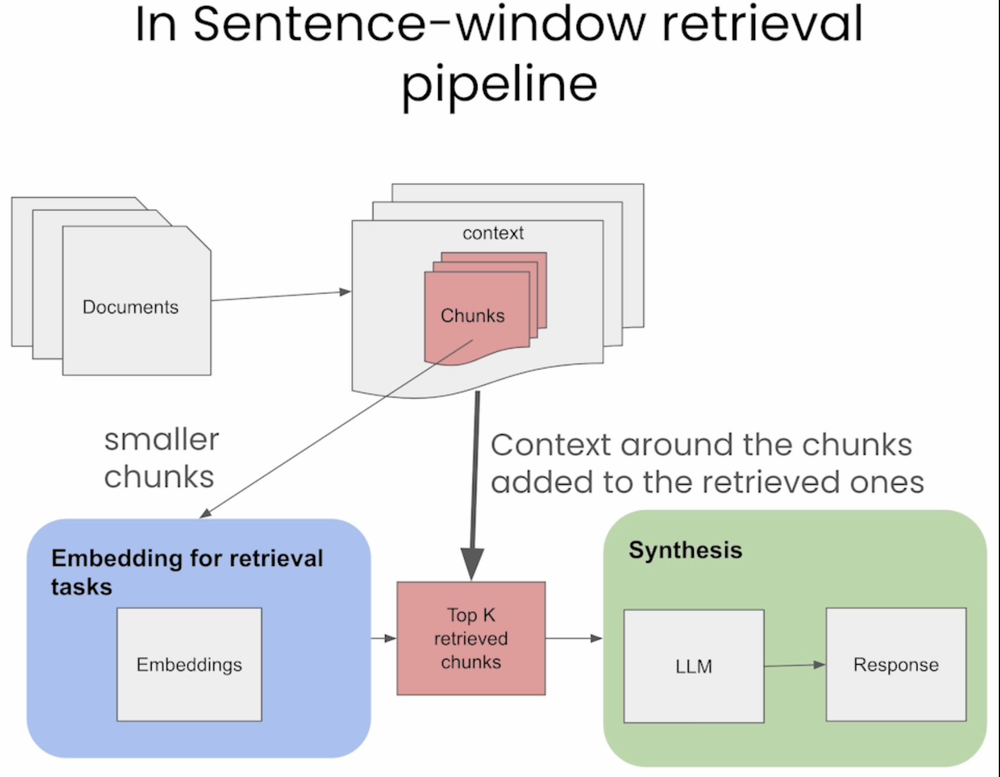

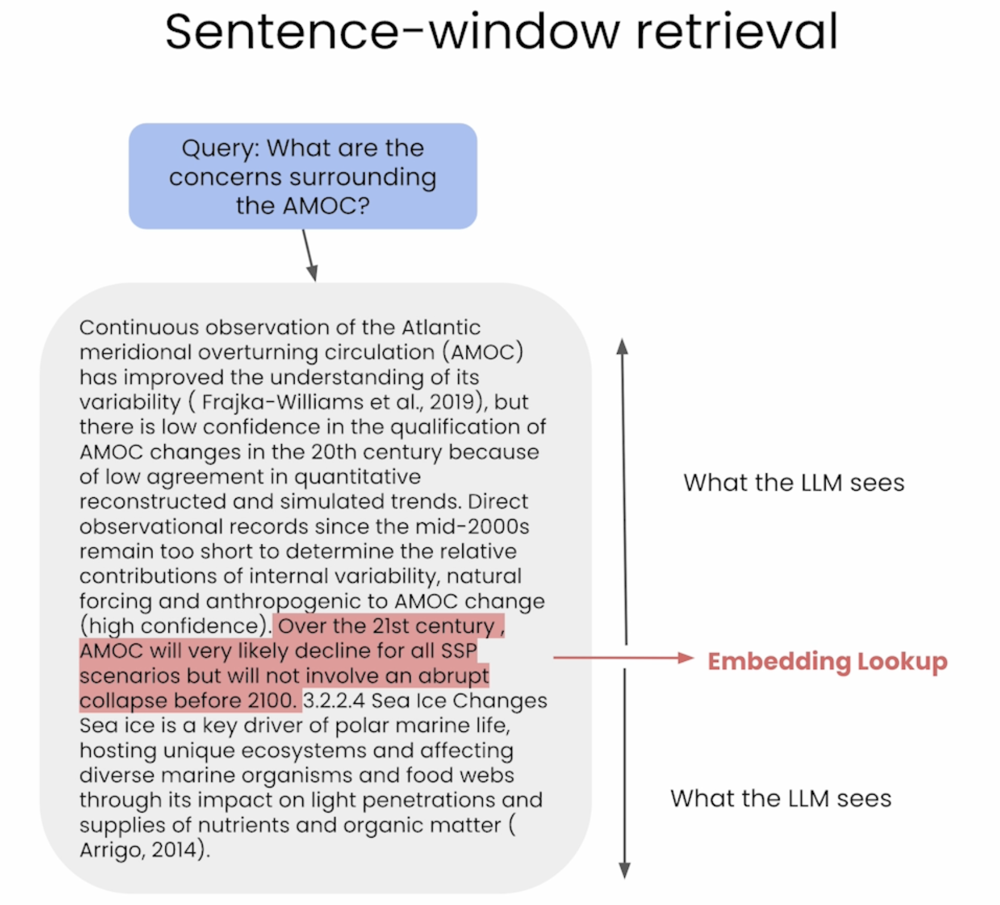

In [1]:
import os
from dotenv import load_dotenv

# Load environment variables from .env file
load_dotenv()


# Ensure the OpenAI API key is set in the environment
openai_api_key = os.getenv('OPENAI_API_KEY')
if not openai_api_key:
    raise ValueError("OPENAI_API_KEY environment variable is not set")

In [63]:
from llama_index.core import SimpleDirectoryReader

documents = SimpleDirectoryReader(
    input_files=["../docs/Basics of Writing Review Articles.pdf"]
).load_data()

In [64]:
from llama_index.core import Document

document = Document(text="\n\n".\
                    join([doc.text for doc in documents]))

## Window-sentence retrieval setup

In [65]:
from llama_index.core.node_parser import SentenceWindowNodeParser

# create the sentence window node parser w/ default settings
node_parser = SentenceWindowNodeParser.from_defaults(
    window_size=3,
    window_metadata_key="window",
    original_text_metadata_key="original_text",
)

In [66]:
text = "hello. how are you? I am fine!  "

nodes = node_parser.get_nodes_from_documents([Document(text=text)])

In [67]:
print([x.text for x in nodes])

['hello. ', 'how are you? ', 'I am fine!  ']


In [68]:
print(nodes[1].metadata["window"])

hello.  how are you?  I am fine!  


In [69]:
text = "hello. foo bar. cat dog. mouse"

nodes = node_parser.get_nodes_from_documents([Document(text=text)])

In [70]:
print([x.text for x in nodes])

['hello. ', 'foo bar. ', 'cat dog. ', 'mouse']


In [71]:
print(nodes[0].metadata["window"])

hello.  foo bar.  cat dog.  mouse


## Building the index

In [72]:
from llama_index.llms.openai import OpenAI
from llama_index.embeddings.openai import OpenAIEmbedding

embed_model = OpenAIEmbedding(model="text-embedding-3-small")

llm = OpenAI(model="gpt-4o-mini", temperature=0.1)

In [73]:
from llama_index.core import VectorStoreIndex

sentence_index = VectorStoreIndex.from_documents(
                                       [document], embed_model=embed_model, llm=llm
)

In [74]:
sentence_index.storage_context.persist(persist_dir="../data/sentence_index")

In [75]:
# This block of code is optional to check
# if an index file exist, then it will load it
# if not, it will rebuild it


from llama_index.core import VectorStoreIndex, StorageContext, load_index_from_storage

if not os.path.exists("..data/sentence_index"):
    sentence_index = VectorStoreIndex.from_documents(
        [document], embed_model=embed_model, llm=llm
    )

    sentence_index.storage_context.persist(persist_dir="../data/sentence_index")
else:
    sentence_index = load_index_from_storage(
        StorageContext.from_defaults(persist_dir="../data/sentence_index"),
        service_context=sentence_context
    )

## Building the postprocessor

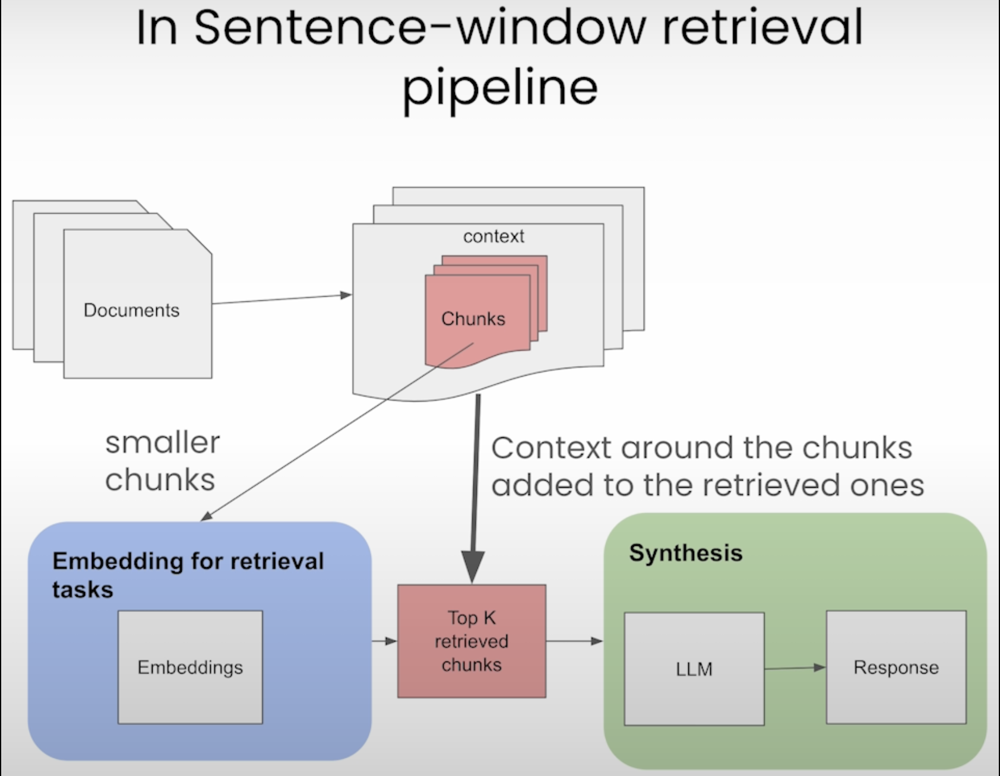

In [76]:
from llama_index.core.postprocessor import MetadataReplacementPostProcessor

postproc = MetadataReplacementPostProcessor(
    target_metadata_key="window"
)

In [77]:
from llama_index.core.schema import NodeWithScore
from copy import deepcopy

scored_nodes = [NodeWithScore(node=x, score=1.0) for x in nodes]
nodes_old = [deepcopy(n) for n in nodes]

In [78]:
nodes_old[1].text

'foo bar. '

In [79]:
replaced_nodes = postproc.postprocess_nodes(scored_nodes)

In [80]:
print(replaced_nodes[1].text)

hello.  foo bar.  cat dog.  mouse


## Adding a reranker

In [81]:
from llama_index.core.postprocessor import SentenceTransformerRerank

# BAAI/bge-reranker-base
# link: https://huggingface.co/BAAI/bge-reranker-base
rerank = SentenceTransformerRerank(
    top_n=2, model="BAAI/bge-reranker-base"
)

/opt/miniconda3/envs/envai/lib/python3.11/site-packages/huggingface_hub/file_download.py:797: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [82]:
from llama_index.core import QueryBundle
from llama_index.core.schema import TextNode, NodeWithScore

query = QueryBundle("I want a dog.")

scored_nodes = [
    NodeWithScore(node=TextNode(text="This is a cat"), score=0.6),
    NodeWithScore(node=TextNode(text="This is a dog"), score=0.4),
]

In [83]:
reranked_nodes = rerank.postprocess_nodes(
    scored_nodes, query_bundle=query
)

In [84]:
print([(x.text, x.score) for x in reranked_nodes])

[('This is a dog', 0.91827416), ('This is a cat', 0.0014040739)]


## Runing the query engine

In [85]:
sentence_window_engine = sentence_index.as_query_engine(
    similarity_top_k=6, node_postprocessors=[postproc, rerank]
)

In [86]:
window_response = sentence_window_engine.query(
    "What are international guidelines to conduct reviews?"
)

In [87]:
from llama_index.core.response.notebook_utils import display_response

display_response(window_response)

**`Final Response:`** PRISMA, Cochrane, and JBI are international guidelines that provide detailed information on how to conduct reviews, starting from the planning and protocol writing phases. These guidelines aim to ensure transparent, unbiased, and complete reporting in review articles.

## Putting it all Together

In [88]:
import os
from llama_index.core import ServiceContext, VectorStoreIndex, StorageContext, load_index_from_storage
from llama_index.core.node_parser import SentenceWindowNodeParser
from llama_index.core.postprocessor import MetadataReplacementPostProcessor
from llama_index.core.postprocessor import SentenceTransformerRerank


def build_sentence_window_index(
    documents,
    llm=llm,
    embed_model=embed_model,
    sentence_window_size=3,
    save_dir="../data/sentence_index",
):
    # create the sentence window node parser w/ default settings
    node_parser = SentenceWindowNodeParser.from_defaults(
        window_size=sentence_window_size,
        window_metadata_key="window",
        original_text_metadata_key="original_text",
    )
    if not os.path.exists(save_dir):
        sentence_index = VectorStoreIndex.from_documents(
            [documents], llm=llm, embed_model=embed_model
        )
        sentence_index.storage_context.persist(persist_dir=save_dir)
    else:
        sentence_index = load_index_from_storage(
            StorageContext.from_defaults(persist_dir=save_dir),
            llm=llm, embed_model=embed_model
        )

    return sentence_index


def get_sentence_window_query_engine(
    sentence_index, similarity_top_k=6, rerank_top_n=2
):
    # define postprocessors
    postproc = MetadataReplacementPostProcessor(target_metadata_key="window")
    rerank = SentenceTransformerRerank(
        top_n=rerank_top_n, model="BAAI/bge-reranker-base"
    )

    sentence_window_engine = sentence_index.as_query_engine(
        similarity_top_k=similarity_top_k, node_postprocessors=[postproc, rerank]
    )
    return sentence_window_engine

In [89]:
from llama_index.llms.openai import OpenAI

index = build_sentence_window_index(
    [document],
    llm=llm,
    save_dir="../data/sentence_index",
)

In [90]:
query_engine = get_sentence_window_query_engine(index, similarity_top_k=6)

/opt/miniconda3/envs/envai/lib/python3.11/site-packages/huggingface_hub/file_download.py:797: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


## TruLens Evaluation

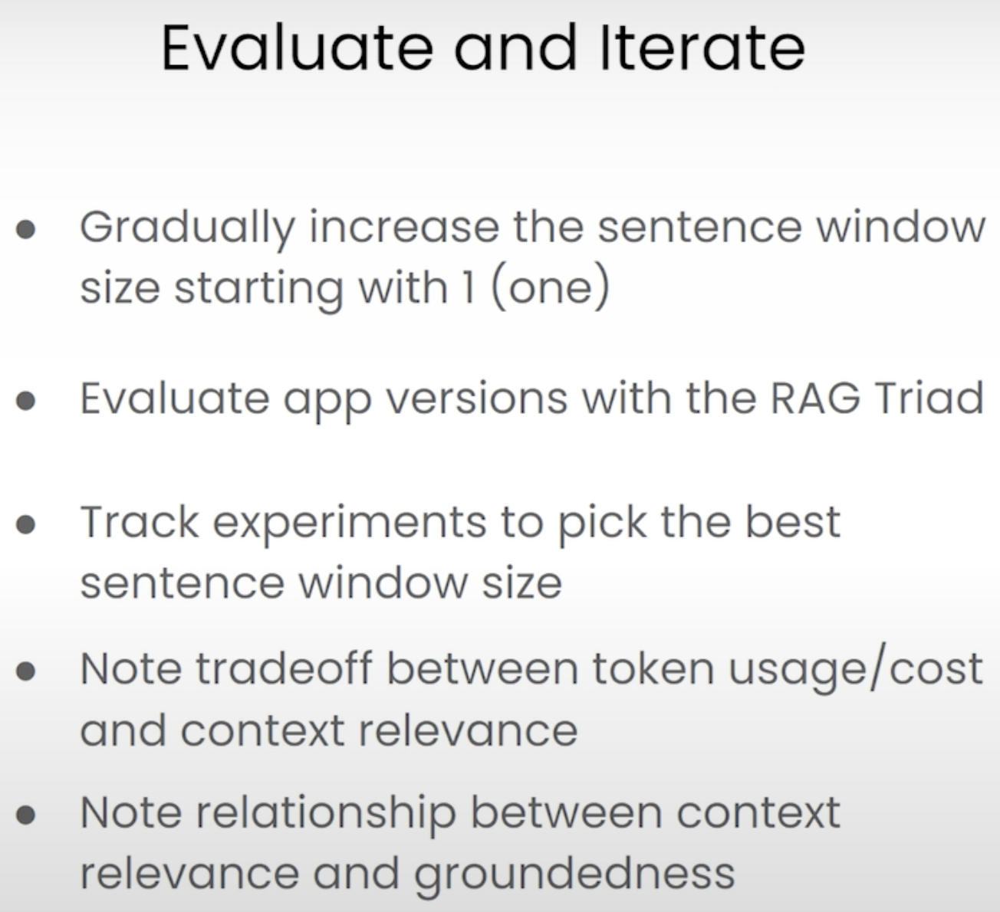

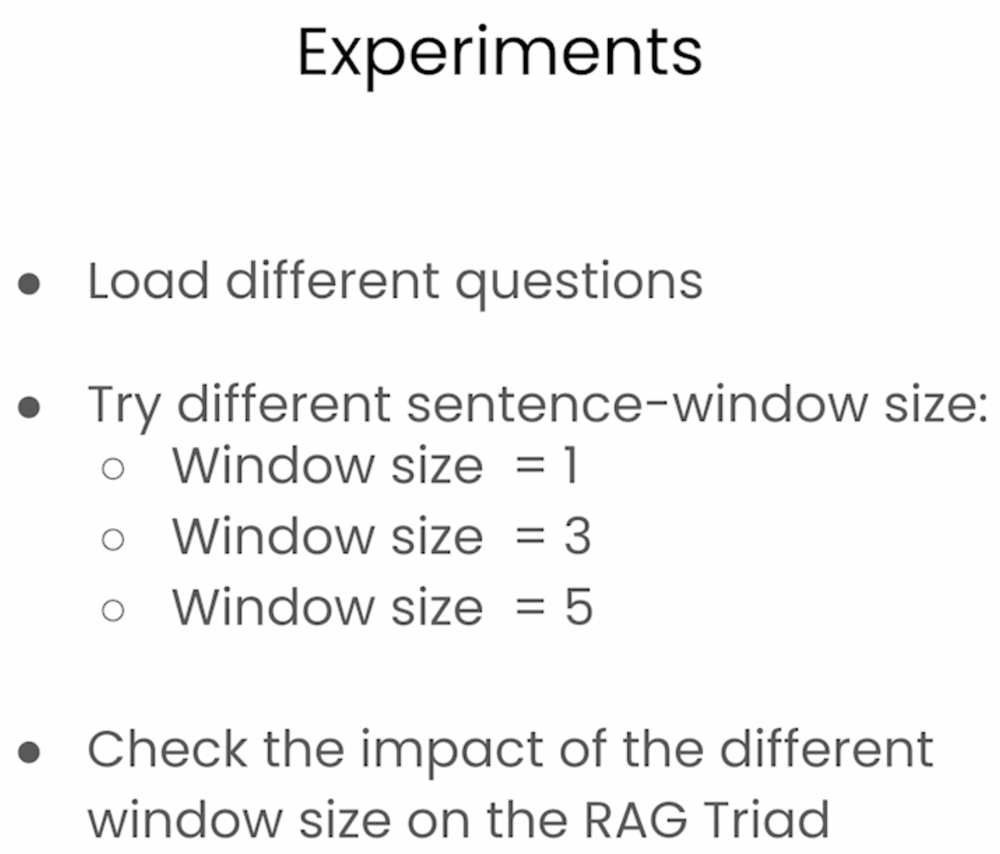

In [91]:
eval_questions = []
with open('../docs/eval_questions.txt', 'r') as file:
    for line in file:
        # Remove newline character and convert to integer
        item = line.strip()
        eval_questions.append(item)

In [92]:
def run_evals(eval_questions, tru_recorder, query_engine):
    for question in eval_questions:
        with tru_recorder as recording:
            response = query_engine.query(question)

In [93]:
import numpy as np
from trulens.core import Feedback
from trulens.apps.llamaindex import TruLlama
from trulens.providers.openai import OpenAI as fOpenAI

provider = fOpenAI(model_engine="gpt-4o-mini")

import nest_asyncio

nest_asyncio.apply()

qa_relevance = (
    Feedback(provider.relevance_with_cot_reasons, name="Answer Relevance")
    .on_input_output()
)

qs_relevance = (
    Feedback(provider.relevance_with_cot_reasons, name = "Context Relevance")
    .on_input()
    .on(TruLlama.select_source_nodes().node.text)
    .aggregate(np.mean)
)

groundedness = (
    Feedback(provider.groundedness_measure_with_cot_reasons,
             name="Groundedness"
            ).on(TruLlama.select_source_nodes().node.text).on_output()
)

feedbacks = [qa_relevance, qs_relevance, groundedness]

def get_prebuilt_trulens_recorder(query_engine, app_id):
    tru_recorder = TruLlama(
        query_engine,
        app_id=app_id,
        feedbacks=feedbacks
        )
    return tru_recorder

✅ In Answer Relevance, input prompt will be set to __record__.main_input or `Select.RecordInput` .
✅ In Answer Relevance, input response will be set to __record__.main_output or `Select.RecordOutput` .
✅ In Context Relevance, input prompt will be set to __record__.main_input or `Select.RecordInput` .
✅ In Context Relevance, input response will be set to __record__.app.query.rets.source_nodes[:].node.text .
✅ In Groundedness, input source will be set to __record__.app.query.rets.source_nodes[:].node.text .
✅ In Groundedness, input statement will be set to __record__.main_output or `Select.RecordOutput` .


In [109]:
from trulens.core import TruSession

session = TruSession()
session.reset_database()

## Sentence window size = 1

In [110]:
from llama_index.llms.openai import OpenAI
from llama_index.embeddings.openai import OpenAIEmbedding

embed_model = OpenAIEmbedding(model="text-embedding-3-small")
llm = OpenAI(model="gpt-4o-mini", temperature=0.1)

sentence_index_1 = build_sentence_window_index(
    document,
    llm=llm,
    embed_model=embed_model,
    sentence_window_size=1,
    save_dir="../data/sentence_index_1",
)

In [111]:
sentence_window_engine_1 = get_sentence_window_query_engine(
    sentence_index_1
)

/opt/miniconda3/envs/envai/lib/python3.11/site-packages/huggingface_hub/file_download.py:797: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [112]:
tru_recorder_1 = get_prebuilt_trulens_recorder(
    sentence_window_engine_1,
    app_id='sentence window engine 1'
)

In [113]:
run_evals(eval_questions, tru_recorder_1, sentence_window_engine_1)

In [114]:
session.get_leaderboard(app_ids=[])

,,Context Relevance,Answer Relevance,Groundedness,latency,total_cost
app_name,app_version,,,,,
sentence window engine 1,base,0.8,1.0,0.902778,2.7,0.002466


In [115]:
run_dashboard(session)

Starting dashboard ...
Config file already exists. Skipping writing process.
Credentials file already exists. Skipping writing process.
Dashboard already running at path:   Network URL: http://192.168.11.8:49616



<Popen: returncode: None args: ['streamlit', 'run', '--server.headless=True'...>

### Note about the dataset of questions ###

Note that running an evaluation on more than one question can take some time, so we recommend a file with 5 questions to run and explore the results.

* For evaluating a personal project, an eval set of 20 is reasonable.

* For evaluating business applications, you may need a set of 100+ in order to cover all the use cases thoroughly.

* Note that since API calls can sometimes fail, you may occasionally see null responses, and would want to re-run your evaluations. So running your evaluations in smaller batches can also help you save time and cost by only re-running the evaluation on the batches with issues.

## Sentence window size = 3

In [116]:
sentence_index_3 = build_sentence_window_index(
    document,
    llm=llm,
    embed_model=embed_model,
    sentence_window_size=3,
    save_dir="../data/sentence_index_3",
)
sentence_window_engine_3 = get_sentence_window_query_engine(
    sentence_index_3
)

tru_recorder_3 = get_prebuilt_trulens_recorder(
    sentence_window_engine_3,
    app_id='sentence window engine 3'
)

/opt/miniconda3/envs/envai/lib/python3.11/site-packages/huggingface_hub/file_download.py:797: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [117]:
run_evals(eval_questions, tru_recorder_3, sentence_window_engine_3)

In [118]:
session.get_leaderboard(app_ids=[])

,,Context Relevance,Answer Relevance,Groundedness,latency,total_cost
app_name,app_version,,,,,
sentence window engine 3,base,0.722222,1.0,NaN,2.9,0.002463
sentence window engine 1,base,0.716667,1.0,0.752646,2.9,0.002466


In [119]:
run_dashboard(session)

Starting dashboard ...
Config file already exists. Skipping writing process.
Credentials file already exists. Skipping writing process.
Dashboard already running at path:   Network URL: http://192.168.11.8:49616



<Popen: returncode: None args: ['streamlit', 'run', '--server.headless=True'...>

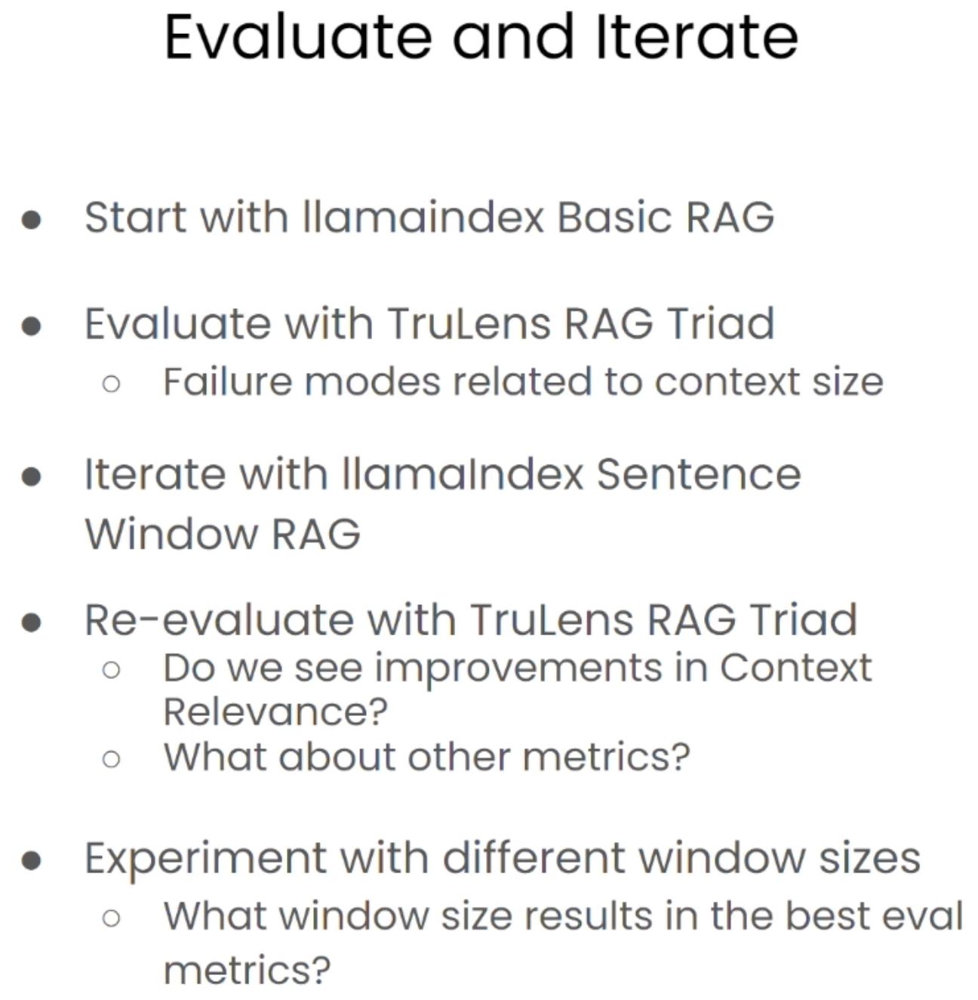

# Lesson 4: Auto-merging Retrieval

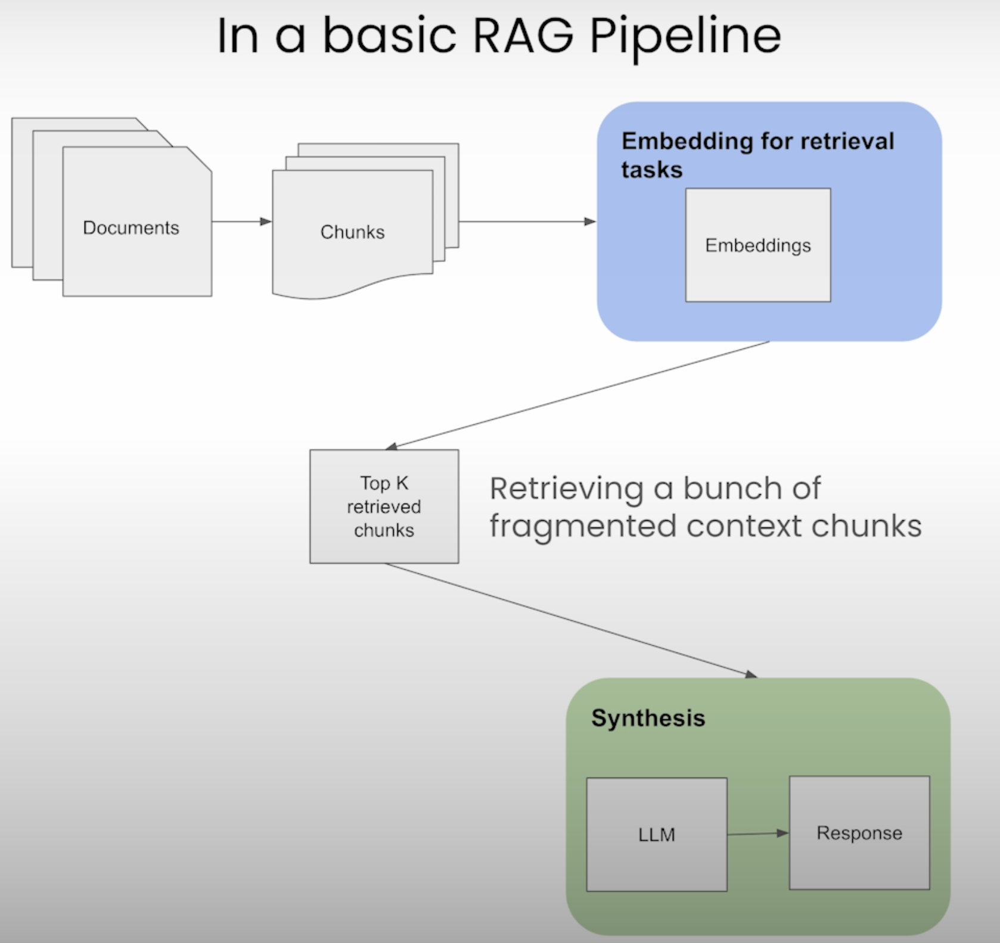

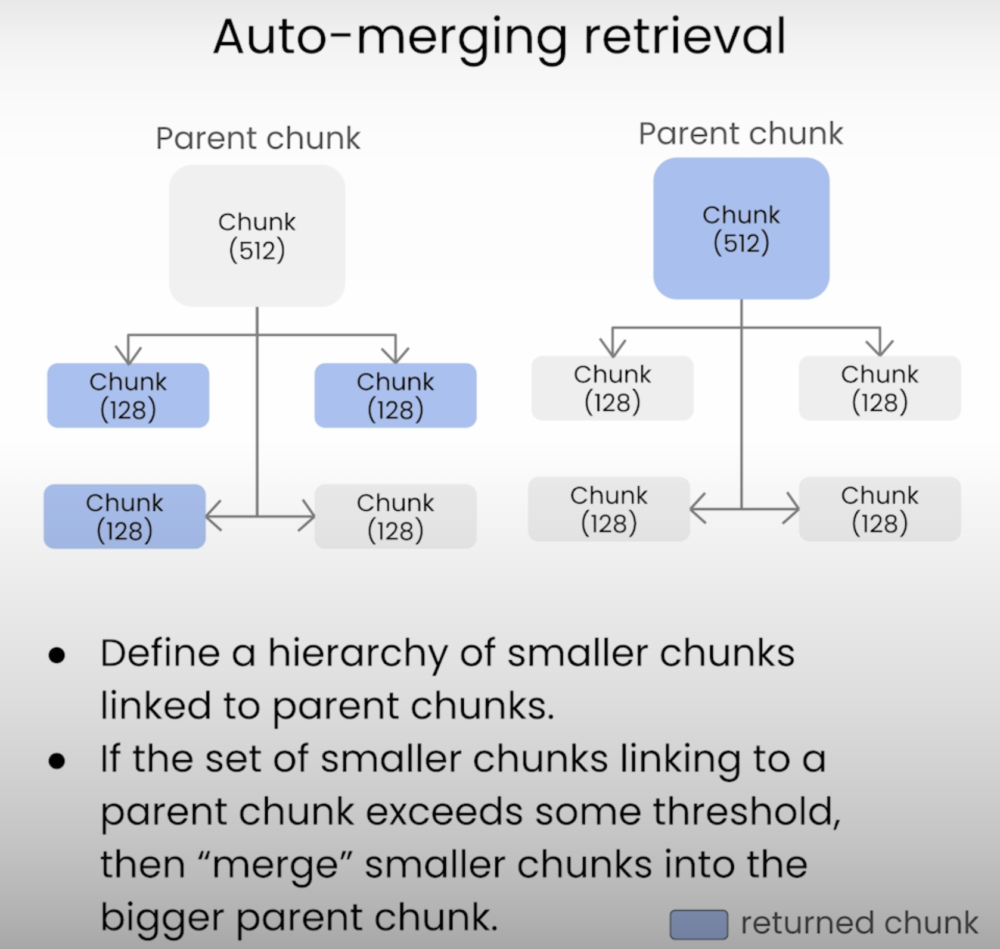

In [1]:
import os
from dotenv import load_dotenv

# Load environment variables from .env file
load_dotenv()


# Ensure the OpenAI API key is set in the environment
openai_api_key = os.getenv('OPENAI_API_KEY')
if not openai_api_key:
    raise ValueError("OPENAI_API_KEY environment variable is not set")

In [120]:
from llama_index.core import SimpleDirectoryReader

documents = SimpleDirectoryReader(
    input_files=["../docs/Basics of Writing Review Articles.pdf"]
).load_data()

In [13]:
print(type(documents), "\n")
print(len(documents), "\n")
print(type(documents[0]))
print(documents[0])

<class 'list'> 

6 

<class 'llama_index.core.schema.Document'>
Doc ID: 3c636eb0-9491-472c-8514-b1da091bd7ee
Text: Evidence-based medicine forms the essence of medical practice in
the modern world. No wonder review articles are the mainstay for
evidence-based medicine. Review articles provide a critical summary of
the existing literature to explain the current state of scientiﬁc
evidence on a particular topic. A well-written review article must
summarize key...


## Auto-merging retrieval setup

In [121]:
from llama_index.core import Document

document = Document(text="\n\n".join([doc.text for doc in documents]))

In [122]:
from llama_index.core.node_parser import HierarchicalNodeParser

# create the hierarchical node parser w/ default settings
node_parser = HierarchicalNodeParser.from_defaults(
    chunk_sizes=[2048, 512, 128]
)

In [123]:
nodes = node_parser.get_nodes_from_documents([document])

In [124]:
from llama_index.core.node_parser import get_leaf_nodes

leaf_nodes = get_leaf_nodes(nodes)
print(leaf_nodes[5].text)

•Independent of the review type, all reviews must have a predeﬁned methodology
•The methods utilized for the review should be explained clearly in the review paper
•Review papers should be written in a structured format
Considering the overwhelming number of diverse review types, the initial burden authors face is to choose the review type that matches their purpose best. Despite the continuous rise in the number of review types, there are sources that provide guidance about this issue (5). Authors are highly recommended to examine and learn about diﬀerent review methodologies before they decide on their review approach.


In [125]:
nodes_by_id = {node.node_id: node for node in nodes}

parent_node = nodes_by_id[leaf_nodes[5].parent_node.node_id]
print(parent_node.text)

•Independent of the review type, all reviews must have a predeﬁned methodology
•The methods utilized for the review should be explained clearly in the review paper
•Review papers should be written in a structured format
Considering the overwhelming number of diverse review types, the initial burden authors face is to choose the review type that matches their purpose best. Despite the continuous rise in the number of review types, there are sources that provide guidance about this issue (5). Authors are highly recommended to examine and learn about diﬀerent review methodologies before they decide on their review approach.
International guidelines such as PRISMA (6), Cochrane (7), and JBI (8) provide detailed information about how to conduct reviews starting from the planning and protocol writing phases. The purpose of these international guidelines is to ensure transparent, unbiased, and complete reporting. Although the guidelines are focused on systematic reviews, they can also be used

### Building the index

In [126]:
from llama_index.embeddings.openai import OpenAIEmbedding
from llama_index.core.node_parser import SentenceSplitter
from llama_index.llms.openai import OpenAI
from llama_index.core import Settings

Settings.llm = OpenAI(model="gpt-4o-mini")
Settings.embed_model = OpenAIEmbedding(model="text-embedding-3-small")
Settings.node_parser = node_parser

In [127]:
from llama_index.core import VectorStoreIndex, StorageContext

storage_context = StorageContext.from_defaults()
storage_context.docstore.add_documents(nodes)

automerging_index = VectorStoreIndex(
    leaf_nodes, storage_context=storage_context#, service_context=auto_merging_context
)

automerging_index.storage_context.persist(persist_dir="../data/merging_index")

In [128]:
# This block of code is optional to check
# if an index file exist, then it will load it
# if not, it will rebuild it

import os
from llama_index.core import VectorStoreIndex, StorageContext, load_index_from_storage
from llama_index.core import load_index_from_storage

if not os.path.exists("../data/merging_index"):
    storage_context = StorageContext.from_defaults()
    storage_context.docstore.add_documents(nodes)

    automerging_index = VectorStoreIndex(
            leaf_nodes,
            storage_context=storage_context,
            #service_context=auto_merging_context
        )

    automerging_index.storage_context.persist(persist_dir="../data/merging_index")
else:
    automerging_index = load_index_from_storage(
        StorageContext.from_defaults(persist_dir="../data/merging_index"),
        #service_context=auto_merging_context
    )

### Defining the retriever and running the query engine

In [129]:
from llama_index.core.postprocessor import SentenceTransformerRerank
from llama_index.core.retrievers import AutoMergingRetriever
from llama_index.core.query_engine import RetrieverQueryEngine

automerging_retriever = automerging_index.as_retriever(
    similarity_top_k=12
)

retriever = AutoMergingRetriever(
    automerging_retriever, 
    automerging_index.storage_context, 
    verbose=True
)

rerank = SentenceTransformerRerank(top_n=6, model="BAAI/bge-reranker-base")

auto_merging_engine = RetrieverQueryEngine.from_args(
    automerging_retriever, node_postprocessors=[rerank]
)

/opt/miniconda3/envs/envai/lib/python3.11/site-packages/huggingface_hub/file_download.py:797: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [130]:
auto_merging_response = auto_merging_engine.query(
    "What is the most important thing of writing a review article?"
)

In [131]:
from llama_index.core.response.notebook_utils import display_response

display_response(auto_merging_response)

**`Final Response:`** The most important aspect of writing a review article is to provide an objective interpretation of the results, guiding readers to better understand the current evidence. This includes summarizing key research findings, discussing limitations and gaps in the literature, and suggesting directions for future research and clinical practice.

## Putting it all Together

In [132]:
import os

from llama_index.core import StorageContext, VectorStoreIndex, load_index_from_storage, Settings

from llama_index.core.node_parser import HierarchicalNodeParser, get_leaf_nodes

from llama_index.core.retrievers import AutoMergingRetriever
from llama_index.core.postprocessor import SentenceTransformerRerank
from llama_index.core.query_engine import RetrieverQueryEngine


def build_automerging_index(
    documents,
    llm,
    embed_model,
    save_dir="../data/merging_index",
    chunk_sizes=None,
):
    chunk_sizes = chunk_sizes or [2048, 512, 128]
    node_parser = HierarchicalNodeParser.from_defaults(chunk_sizes=chunk_sizes)
    nodes = node_parser.get_nodes_from_documents(documents)
    leaf_nodes = get_leaf_nodes(nodes)
    Settings.llm = OpenAI(model="gpt-4o-mini")
    Settings.embed_model = OpenAIEmbedding(model="text-embedding-3-small")
    storage_context = StorageContext.from_defaults()
    storage_context.docstore.add_documents(nodes)

    if not os.path.exists(save_dir):
        automerging_index = VectorStoreIndex(
            leaf_nodes, storage_context=storage_context#, service_context=merging_context
        )
        automerging_index.storage_context.persist(persist_dir=save_dir)
    else:
        automerging_index = load_index_from_storage(
            StorageContext.from_defaults(persist_dir=save_dir)#,
            #service_context=merging_context,
        )
    return automerging_index


def get_automerging_query_engine(
    automerging_index,
    similarity_top_k=12,
    rerank_top_n=6,
):
    base_retriever = automerging_index.as_retriever(similarity_top_k=similarity_top_k)
    retriever = AutoMergingRetriever(
        base_retriever, automerging_index.storage_context, verbose=True
    )
    rerank = SentenceTransformerRerank(
        top_n=rerank_top_n, model="BAAI/bge-reranker-base"
    )
    auto_merging_engine = RetrieverQueryEngine.from_args(
        retriever, node_postprocessors=[rerank]
    )
    return auto_merging_engine

In [133]:
from llama_index.llms.openai import OpenAI
from llama_index.embeddings.openai import OpenAIEmbedding

index = build_automerging_index(
    [document],
    llm=OpenAI(model="gpt-4o-mini", temperature=0.1),
    embed_model = OpenAIEmbedding(model="text-embedding-3-small"),
    save_dir="../data/merging_index",
)

In [134]:
query_engine = get_automerging_query_engine(index, similarity_top_k=6)

## TruLens Evaluation

In [135]:
from trulens.core import TruSession

session = TruSession()
session.reset_database()

### Two layers

In [136]:
auto_merging_index_0 = build_automerging_index(
    [document],
    llm=OpenAI(model="gpt-4o-mini", temperature=0.1),
    embed_model=OpenAIEmbedding(model="text-embedding-3-small"),
    save_dir="../data/merging_index_0",
    chunk_sizes=[2048,512],
)

In [137]:
auto_merging_engine_0 = get_automerging_query_engine(
    auto_merging_index_0,
    similarity_top_k=12,
    rerank_top_n=6,
)

In [146]:
from trulens.providers.openai import OpenAI as fOpenAI
from trulens.core import Feedback
import numpy as np

from trulens.apps.llamaindex import TruLlama

def get_prebuilt_trulens_recorder(query_engine, app_id):

    openai = fOpenAI()

    qa_relevance = (
        Feedback(openai.relevance_with_cot_reasons, name="Answer Relevance")
        .on_input_output()
    )

    qs_relevance = (
        Feedback(openai.relevance_with_cot_reasons, name = "Context Relevance")
        .on_input()
        .on(TruLlama.select_source_nodes().node.text)
        .aggregate(np.mean)
    )

    groundedness = (
        Feedback(
            openai.groundedness_measure_with_cot_reasons, name="Groundedness"
            )
        .on(TruLlama.select_source_nodes().node.text)  
        .on_output()
    )

    feedbacks = [qa_relevance, qs_relevance, groundedness]
    tru_recorder = TruLlama(
        query_engine,
        app_id=app_id,
        feedbacks=feedbacks
    )
    return tru_recorder

In [147]:
tru_recorder = get_prebuilt_trulens_recorder(
    auto_merging_engine_0,
    app_id ='app_0'
)

✅ In Answer Relevance, input prompt will be set to __record__.main_input or `Select.RecordInput` .
✅ In Answer Relevance, input response will be set to __record__.main_output or `Select.RecordOutput` .
✅ In Context Relevance, input prompt will be set to __record__.main_input or `Select.RecordInput` .
✅ In Context Relevance, input response will be set to __record__.app.query.rets.source_nodes[:].node.text .
✅ In Groundedness, input source will be set to __record__.app.query.rets.source_nodes[:].node.text .
✅ In Groundedness, input statement will be set to __record__.main_output or `Select.RecordOutput` .


In [140]:
eval_questions = []
with open('../docs/eval_questions.txt', 'r') as file:
    for line in file:
        # Remove newline character and convert to integer
        item = line.strip()
        eval_questions.append(item)

In [141]:
def run_evals(eval_questions, tru_recorder, query_engine):
    for question in eval_questions:
        with tru_recorder as recording:
            response = query_engine.query(question)

In [142]:
run_evals(eval_questions, tru_recorder, auto_merging_engine_0)

> Merging 1 nodes into parent node.
> Parent node id: 316f8d4a-f83b-4109-bb41-89ac65576d09.
> Parent node text: Evidence-based medicine forms the essence of medical practice in the modern world. No wonder revi...

> Merging 1 nodes into parent node.
> Parent node id: a14fb260-eb04-4e81-b63d-01fd6d7574ed.
> Parent node text: Discussion section provides a general interpretation of the results and presents expert opinion. ...

> Merging 1 nodes into parent node.
> Parent node id: 9e0a55dc-1a34-473a-8da2-a7f44cf31c21.
> Parent node text: the subject within a broad spectrum. No formal guidance exists for traditional reviews. However, ...

> Merging 1 nodes into parent node.
> Parent node id: 4dd09356-2dc9-44c1-b888-f0fafdd77dff.
> Parent node text: recent papers in the future. Explicit scientiﬁc methods are required for systematic reviews as de...

> Merging 1 nodes into parent node.
> Parent node id: cff854e4-328a-485c-9813-6695a61d4cd5.
> Parent node text: •Independent of the review type,

In [143]:
session.get_leaderboard(app_ids=[])

,,Context Relevance,Answer Relevance,latency,total_cost
app_name,app_version,,,,
app_0,base,0.555556,1.0,4.7,0.000328


In [144]:
run_dashboard(session)

Starting dashboard ...
Config file already exists. Skipping writing process.
Credentials file already exists. Skipping writing process.
Dashboard already running at path:   Network URL: http://192.168.11.8:49616



<Popen: returncode: None args: ['streamlit', 'run', '--server.headless=True'...>

### Three layers

In [150]:
from llama_index.llms.openai import OpenAI
from llama_index.embeddings.openai import OpenAIEmbedding

auto_merging_index_1 = build_automerging_index(
    documents,
    llm=OpenAI(model="gpt-4o-mini", temperature=0.1),
    embed_model=OpenAIEmbedding(model="text-embedding-3-small"),
    save_dir="../data/merging_index_1",
    chunk_sizes=[2048,512,128],
)

In [151]:
auto_merging_engine_1 = get_automerging_query_engine(
    auto_merging_index_1,
    similarity_top_k=12,
    rerank_top_n=6,
)

/opt/miniconda3/envs/envai/lib/python3.11/site-packages/huggingface_hub/file_download.py:797: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [152]:
tru_recorder = get_prebuilt_trulens_recorder(
    auto_merging_engine_1,
    app_id ='app_1'
)

✅ In Answer Relevance, input prompt will be set to __record__.main_input or `Select.RecordInput` .
✅ In Answer Relevance, input response will be set to __record__.main_output or `Select.RecordOutput` .
✅ In Context Relevance, input prompt will be set to __record__.main_input or `Select.RecordInput` .
✅ In Context Relevance, input response will be set to __record__.app.query.rets.source_nodes[:].node.text .
✅ In Groundedness, input source will be set to __record__.app.query.rets.source_nodes[:].node.text .
✅ In Groundedness, input statement will be set to __record__.main_output or `Select.RecordOutput` .


In [153]:
run_evals(eval_questions, tru_recorder, auto_merging_engine_1)

> Merging 3 nodes into parent node.
> Parent node id: 832429ec-bfd4-47d9-bc2e-bf3b14ad4609.
> Parent node text: Evidence-based medicine forms the essence of medical practice in the modern world. No wonder revi...

> Merging 2 nodes into parent node.
> Parent node id: 0e57e55f-9173-4ba8-8ffa-3038f5243d30.
> Parent node text: the subject within a broad spectrum. No formal guidance exists for traditional reviews. However, ...

> Merging 3 nodes into parent node.
> Parent node id: b6f24005-3482-4dad-a83d-0f67d5a3f510.
> Parent node text: Discussion section provides a general interpretation of the results and presents expert opinion. ...

> Merging 2 nodes into parent node.
> Parent node id: 1899f687-5313-4685-97f3-3d5569dd28fb.
> Parent node text: •Independent of the review type, all reviews must have a predeﬁned methodology
•The methods utili...

> Merging 2 nodes into parent node.
> Parent node id: 0e6363c6-14d0-433b-8dfd-4d631eaf4f90.
> Parent node text: recent papers in the future. Exp

In [154]:
session.get_leaderboard(app_ids=[])

,,Context Relevance,Answer Relevance,Groundedness,latency,total_cost
app_name,app_version,,,,,
app_1,base,0.444444,1.0,NaN,5.2,0.000299
app_0,base,0.433333,1.0,0.328992,5.2,0.000328


In [155]:
run_dashboard(session)

Starting dashboard ...
Config file already exists. Skipping writing process.
Credentials file already exists. Skipping writing process.
Dashboard already running at path:   Network URL: http://192.168.11.8:49616



<Popen: returncode: None args: ['streamlit', 'run', '--server.headless=True'...>

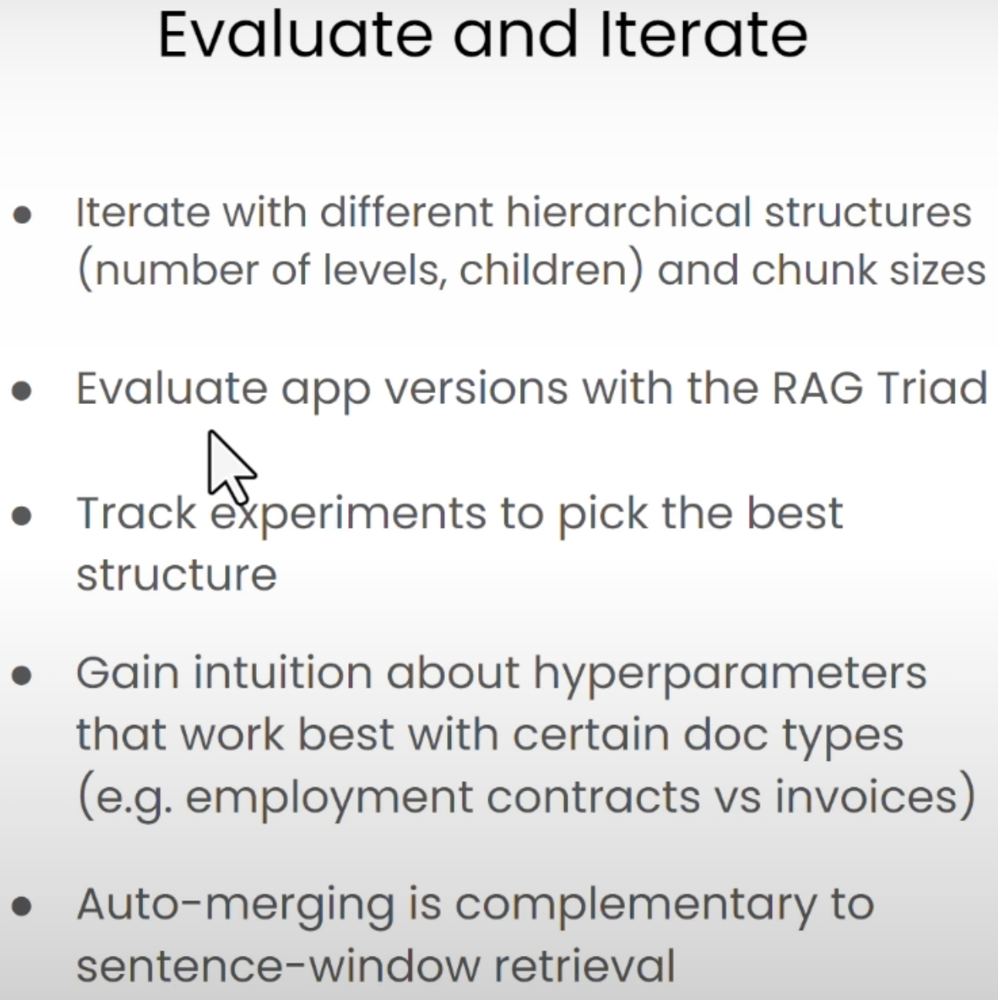

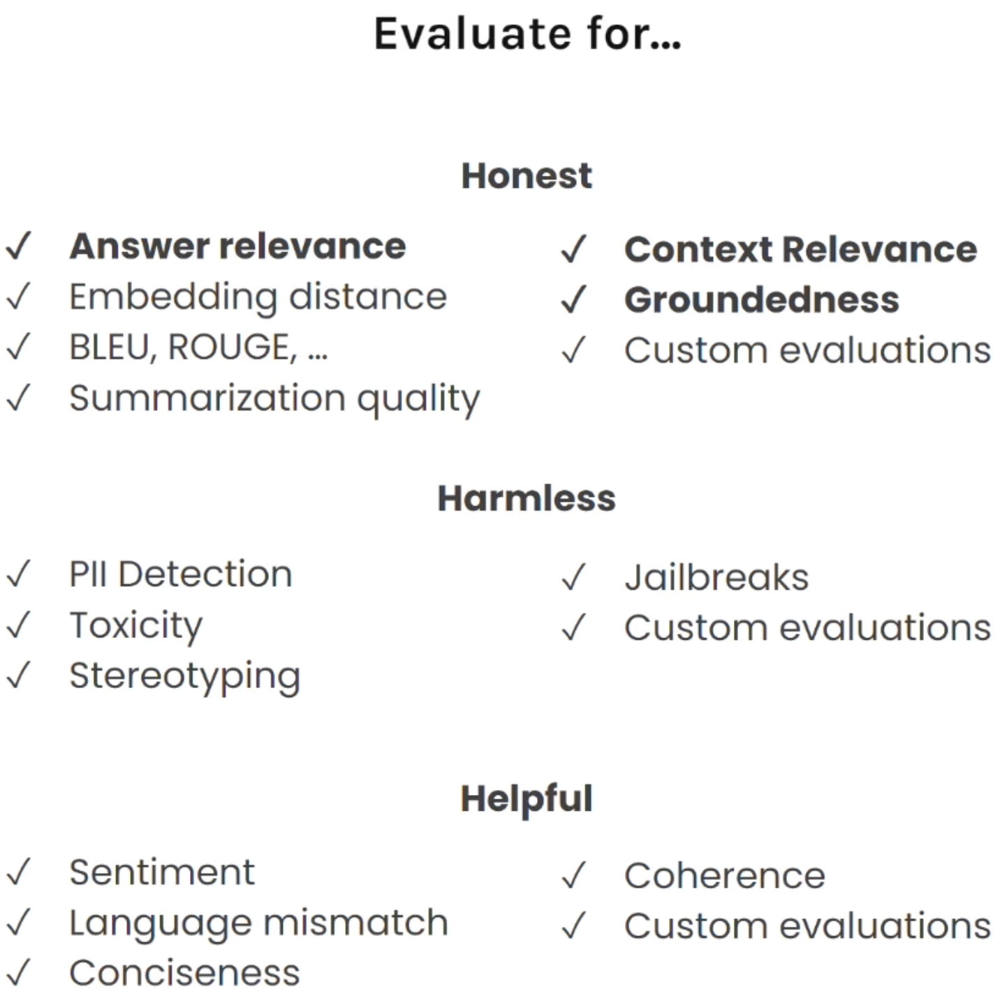